# The second part of the assignment, IDS 2021-2022
In this Jupyter notebook document all your results and the way you have obtained them. Please use the _Python environment_ provided for this part of the assignment. In addition to the _Jupyter notebook_, please submit _one zip-file_ containing  other outputs you have generated that are not included in this notebook (such as pdf, jpg, and others). Please make sure that the other outputs are easily identifiable, i.e. use names as requested in the corresponding question. _You do not need to include the datasets._

This is the _only_ submission that is required (Jupyter notebook + zip-file). A separate report is _not_ needed and will not be considered for grading. 

Give your commented Python code and answers in the corresponding provided cells. Make sure to answer all questions in a clear and explicit manner and discuss your outputs. _Please do not change the general structure of this notebook_. You can, however, add additional markdown or code cells if necessary. <b>Please DO NOT CLEAR THE OUTPUT of the notebook you are submitting! </b>

<font color="red"> Please make sure to include the names and matriculation numbers of all group members in the slot provided below. </font> If a name or a student id is missing, the student will not receive any points.

<font color="red">Plan your time wisely. </font> A few parts of this assignment might take some time to run. It might be necessary to consider time management when you plan your group work.

Hint: RWTHmoodle allows multiple submissions, with every new submission overwriting the previous one. <b>Partial submissions are therefore possible and encouraged. </b> This might be helpful in case of technical issues with RWTHMoodle, which may occur close to the deadline.


<font color="red"><b>Student Names and IDs:
    
    1. Miguel Franken, 358025

    2. Sehrish Khan, 414341

    3. Malek Alhelwany, 391558

# Setup

In [1]:
### Display
from IPython.core.display import display, HTML

### Widgets
#import ipywidgets as widgets

### Data Handline
import pandas as pd
import numpy as np

### Utility
import math
import string
import datetime
import pickle

### Plotting
# Matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm
# Matplotlib toolkits
from mpl_toolkits.axes_grid1 import make_axes_locatable
# Seaborn
import seaborn as sns
# Plotly
import plotly.graph_objects as go
# Gespatial data with cartopy
#import cartopy.crs as ccrs
#import cartopy.feature as cfeature

### Sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import KNNImputer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import SGDClassifier
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split


### Frequent Pattern Mining
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import fpgrowth
from mlxtend.frequent_patterns import association_rules as arule

### Text Mining
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import sent_tokenize
from nltk.stem.snowball import SnowballStemmer
from nltk.stem import WordNetLemmatizer
from nltk.lm.preprocessing import padded_everygram_pipeline
from nltk.lm import MLE
from gensim.models.doc2vec import Doc2Vec, TaggedDocument


/Users/miguelfranken/opt/anaconda3/envs/IDS20212/lib/python3.8/site-packages/gensim/similarities/__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


In [2]:
# Pandas indexing
idx = pd.IndexSlice

Be careful if you use the **matplotlib widget** magic. If you do not close the created plots, previous plots may change if you create a new one.
So if you use this magic command, be careful about your outputs in your final submission.

In [3]:
%matplotlib inline

# Q1 - Preprocessing (20 points)
In this question, we consider a US-census dataset (**census_data.csv**).
Each row contains statistics of a certain tract on a variety of, particularly income- and work-related, life aspects of US citizens.
Short column description:

| Column | Description |
| ------ | ----------- |
| CensusTract | Tract |
| State | State |
| County | County |
| TotalPop | Total population  |
| Men | Number of men |
| Women | Number of women |
| Hispanic, White, Black, Native, Asian, Pacific | Percentage of ethnic group |
| Citizen | Percentage of citizen |
| Income | Median household income |
| IncomePerCap | Income per capita |
| Poverty | Poverty rate |
| ChildPoverty | Child poverty rate |
| Professional | Employed in management, business, science, and arts (percentage) |
| Service, Office, Construction, Production | Other profession fields (percentage) |
| PrivateWork, PublicWork | Employed in private / public sector (percentage) |
| Drive, Carpool, Transit, Walk, OtherTransp | Means of commuting (percentage) |
| WorkAtHome | Working at home (percentage) |
| MeanCommute | Mean time for commuting |
| Employed | Number of employed |
| SelfEmployed | Self-employed (percentage) |
| FamilyWork | Unpaid family work (percentage) |
| Unemployment | Unemployment rate |


## Loading the Data and Initial Quality Investigation

**a)** Load the dataset into a dataframe `df`. <font color='red'>Use the CensusTract as index for your dataframe</font>. In doing so, ensure that the index is valid, that is, it does not contain any duplicate entries.

**In the subsequent questions, only modify the dataframe `df` if explicitly requested. However, you can always create working copies.**

In [543]:
df = pd.read_csv('../data/census_data.csv')
assert df.CensusTract.duplicated().any() == False # index should not contain duplicates
df.set_index('CensusTract', inplace=True)

**b)** Show the data types of the dataframe columns as well as the first few rows. On the first sight, are there any data type problems (e.g., numerical columns having a non-numerical data type)? 

In [385]:
print(df.dtypes)
df.head()

State            object
County           object
TotalPop          int64
Men             float64
Women           float64
Hispanic        float64
White           float64
Black           float64
Native          float64
Asian           float64
Pacific         float64
Citizen           int64
Income          float64
IncomePerCap    float64
Poverty         float64
ChildPoverty    float64
Professional    float64
Service         float64
Office          float64
Construction    float64
Production      float64
Drive           float64
Carpool         float64
Transit         float64
Walk            float64
OtherTransp     float64
WorkAtHome      float64
MeanCommute     float64
Employed          int64
PrivateWork     float64
PublicWork      float64
SelfEmployed    float64
FamilyWork      float64
Unemployment    float64
dtype: object


,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,...,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
CensusTract,,,,,,,,,,,,,,,,,,,,,
1001020100,Alabama,Autauga,1948,940.0,1008.0,0.9,87.4,7.7,0.3,0.6,...,0.5,2.3,2.1,25.0,943,77.1,18.3,4.6,0.0,5.4
1001020200,Alabama,Autauga,2156,1059.0,1097.0,0.8,40.4,53.3,0.0,2.3,...,0.0,0.7,0.0,23.4,753,77.0,16.9,6.1,0.0,13.3
1001020300,Alabama,Autauga,2968,1364.0,1604.0,0.0,74.5,18.6,0.5,1.4,...,0.0,0.0,2.5,19.6,1373,64.1,23.6,12.3,0.0,6.2
1001020400,Alabama,Autauga,4423,2172.0,2251.0,10.5,82.8,3.7,1.6,0.0,...,0.0,2.6,1.6,25.3,1782,75.7,21.2,3.1,0.0,10.8
1001020500,Alabama,Autauga,10763,4922.0,5841.0,0.7,68.5,24.8,0.0,3.8,...,0.0,0.6,0.9,24.8,5037,67.1,27.6,5.3,0.0,4.2


The data type of the `Men` and `Women` columns is a `float64`. However, the description of the column says that these columns contain the number of men and women, so it should always be a whole value and not a decimal value.

The description of the `Citizen` column says that it contains a percentage value, but the data it contains is not percentage data.

Otherwise, there is no numeric column that contains non-numeric data or vice versa.

**c)** To improve performance and memory usage (in particular for large datasets) it is important to use **categorical** columns whenever suitable. 
Are there any categorical column candidates? Explain your answer. \
Afterwards, convert these columns into categorical columns.

In [544]:
df['County'] = df['County'].astype('category')
df['State'] = df['State'].astype('category')

In the given dataset, the columns `State` and `County` contain data for which no numerical operations can be performed. Therefore, these two columns should be converted to the `category` type. All other columns have a mathematical numerical meaning and therefore cannot be converted.

**d)** To select a good strategy to deal with missing data, it is important to get an overview over the general data distribution.
Show the basic statistics for the dataset and create 6 boxplots for the following column groupings:

    ['TotalPop', 'Men', 'Women', 'Citizen', 'Employed'],
    ['Income', 'IncomePerCap'],
    ['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific'],
    ['PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork', 'Unemployment', 'Poverty', 'ChildPoverty'],
    ['Professional', 'Service', 'Office', 'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome'],
    ['MeanCommute']

Can you spot any (severe) data quality problems, in particular, are there unrealistic values (also considering the semantics)?

*Hint: Use the `df.describe()` function.*

In [551]:
def plot_boxplot(columns):
    df_filtered = df.filter(columns, axis=1)
    plt.figure(figsize=(15,25), dpi=300)
    sns.boxplot(data=df_filtered)

def describe(columns):
    df_filtered = df.filter(columns, axis=1)
    print(df_filtered.describe())

           TotalPop           Men         Women       Citizen      Employed
count  74001.000000  73622.000000  73640.000000  74001.000000  74001.000000
mean    4325.591465   2127.937437   2197.755337   3043.079566   1983.907366
std     2129.306903   1072.200320   1095.899964   1475.492946   1073.429808
min        0.000000      0.000000      0.000000      0.000000      0.000000
25%     2891.000000   1409.000000   1460.000000   2037.000000   1249.000000
50%     4063.000000   1987.000000   2066.000000   2863.000000   1846.000000
75%     5442.000000   2674.000000   2774.000000   3838.000000   2553.000000
max    53812.000000  27962.000000  27250.000000  37416.000000  24075.000000


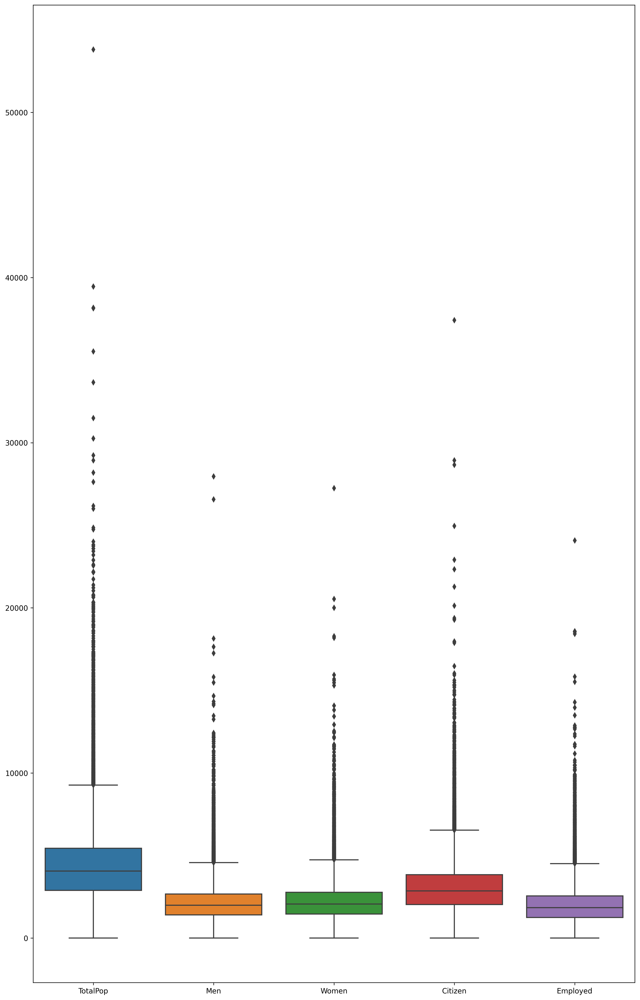

In [552]:
columns_1 = ['TotalPop', 'Men', 'Women', 'Citizen', 'Employed']
plot_boxplot(columns_1)
describe(columns_1)

For all of these boxplots there exist unrealistic values. There is a huge gap between the highest outlier and the rest of the other outliers so that these seem unrealstic.

           Hispanic         White         Black        Native         Asian  \
count  73311.000000  73311.000000  73311.000000  73311.000000  73311.000000   
mean      16.862810     62.032106     13.272581      0.727726      4.588253   
std       22.940695     30.684152     21.762483      4.488340      8.794003   
min        0.000000      0.000000      0.000000      0.000000      0.000000   
25%        2.400000     39.400000      0.700000      0.000000      0.200000   
50%        7.000000     71.400000      3.700000      0.000000      1.400000   
75%       20.400000     88.300000     14.400000      0.400000      4.800000   
max      100.000000    100.000000    100.000000    100.000000     91.300000   

            Pacific  
count  73311.000000  
mean       0.145012  
std        1.037354  
min        0.000000  
25%        0.000000  
50%        0.000000  
75%        0.000000  
max       84.700000  


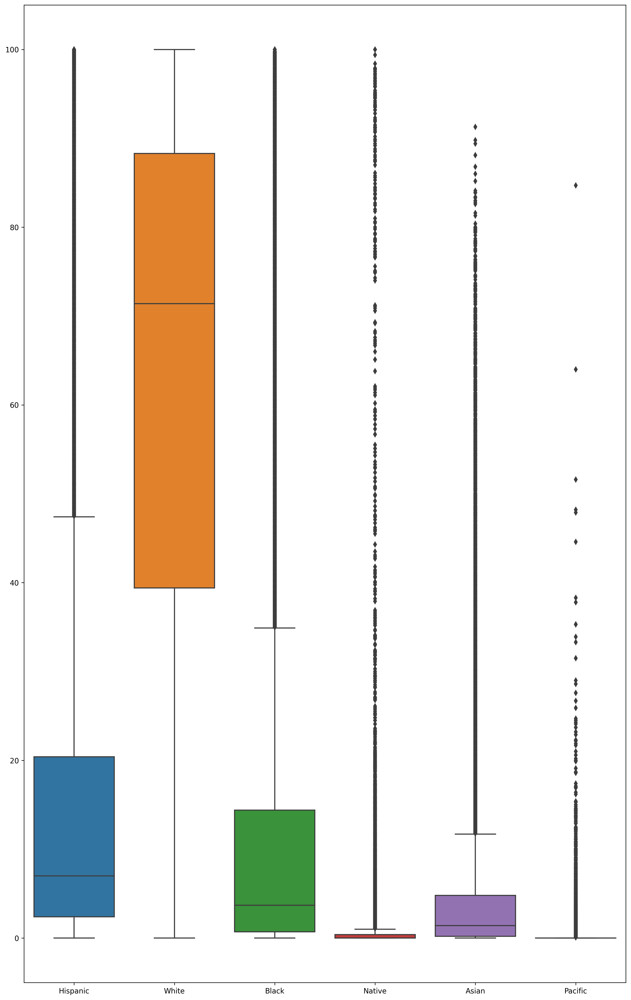

In [553]:
columns_2 = ['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific']
plot_boxplot(columns_2)
describe(columns_2)

From the figure it is clear that highest population is of `White` ethnicity, with a slight overlap with `Haspanic` ethnicity. And it is left skewed.
Mean value of 'Native' and 'Pacific' near 0 indicates that these ethnicities can seldom be found in any of the county regions in the USA. Interestingly there are some outliers for the `Pacific` ethnicity. Therefore, there are some county regions with a majority of people from this ethnicity.
For Asian people this is the same but not as drastic as for the `Pacific` or `Native` ehtnicities.
`Black` and `Hispanic` are highly right skewed.

              Income   IncomePerCap
count   72901.000000   73261.000000
mean    57225.564862   28491.234299
std     28663.331962   15047.068660
min      2611.000000     128.000000
25%     37683.000000   19123.000000
50%     51094.000000   25344.000000
75%     70117.000000   33894.000000
max    248750.000000  254204.000000


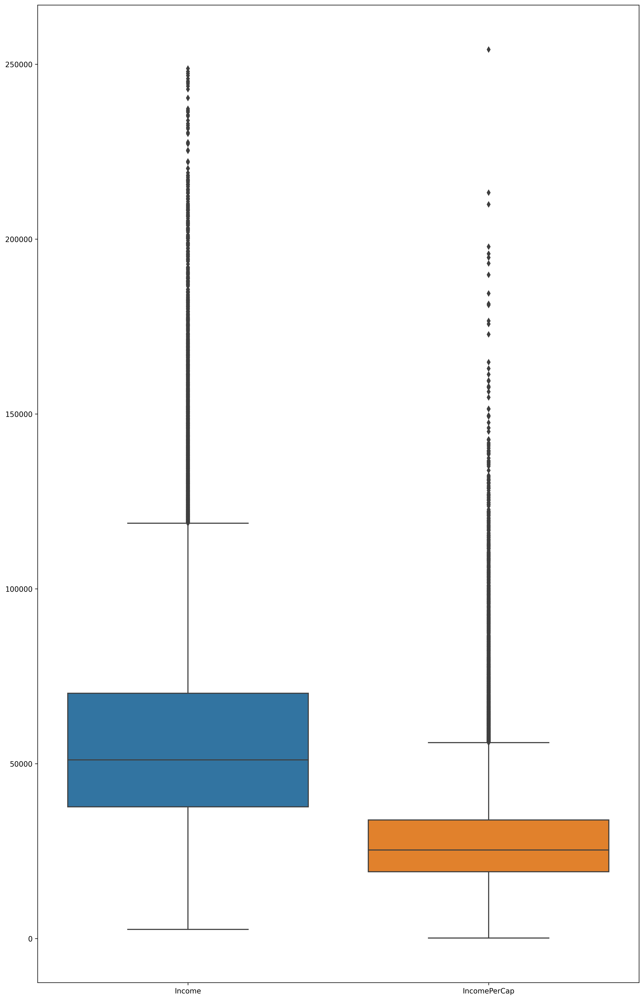

In [554]:
columns_3 = ['Income', 'IncomePerCap']
plot_boxplot(columns_3)
describe(columns_3)

The values of Income (Median household income) and IncomePerCap (measure of the amount of money earned per person in a nation) seems unrealistic. The average of 'Income' is much bigger than 'IncomePerCap' that should have a higher value, as it takes in account of all earning persons in a country.

Also, the highest outlier for income per capita seems unrealistic as it lies far beyond the other outliers and even further away from the median income per capita.

        PrivateWork    PublicWork  SelfEmployed    FamilyWork  Unemployment  \
count  73194.000000  73194.000000  73194.000000  73194.000000  73199.000000   
mean      78.975238     14.621566      6.233814      0.169772      9.028663   
std        8.345758      7.535786      4.042990      0.458227      5.955441   
min        0.000000      0.000000      0.000000      0.000000      0.000000   
25%       74.600000      9.600000      3.500000      0.000000      5.100000   
50%       80.100000     13.400000      5.500000      0.000000      7.700000   
75%       84.600000     18.200000      8.100000      0.000000     11.400000   
max      100.000000    100.000000    100.000000     26.500000    100.000000   

            Poverty  ChildPoverty  
count  73166.000000  72883.000000  
mean      16.958020     22.486827  
std       13.196518     19.190909  
min        0.000000      0.000000  
25%        7.200000      7.000000  
50%       13.400000     17.800000  
75%       23.100000     33.800000  


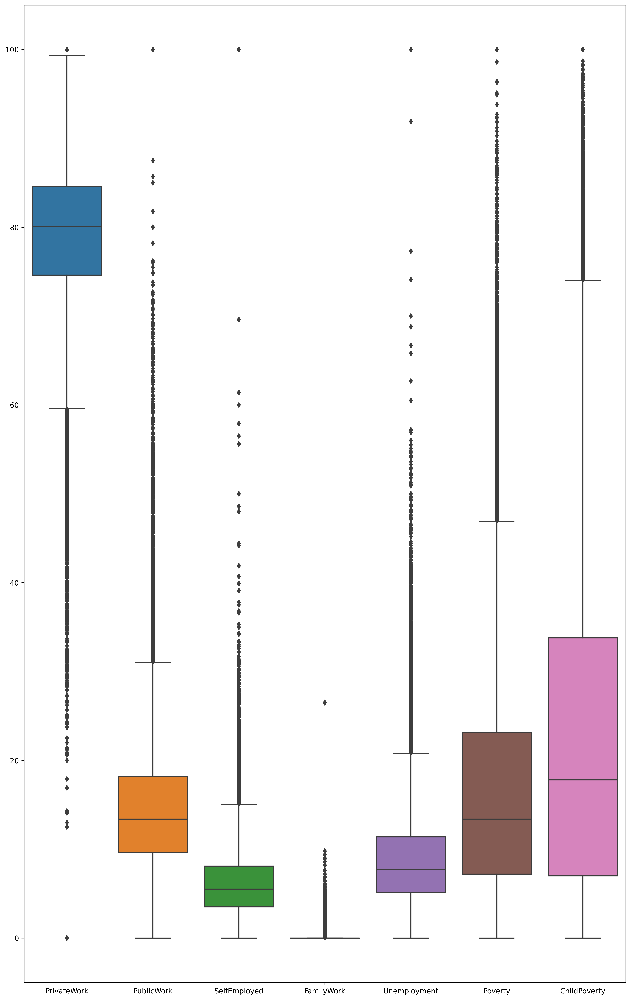

In [555]:
columns_4 = ['PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork', 'Unemployment', 'Poverty', 'ChildPoverty']
plot_boxplot(columns_4)
describe(columns_4)

It seems unrealistic that in a whole county the unemployment rate is 100%. The same for `PublicWork` and all the other presented boxplots.

       Professional       Service        Office  Construction    Production  \
count  73194.000000  73194.000000  73194.000000  73194.000000  73194.000000   
mean      34.798843     19.101381     23.951559      9.292337     12.856005   
std       15.007075      8.279143      5.957279      6.023290      7.671588   
min        0.000000      0.000000      0.000000      0.000000      0.000000   
25%       24.100000     13.400000     20.100000      5.000000      7.100000   
50%       32.600000     17.900000     23.800000      8.400000     11.800000   
75%       43.875000     23.600000     27.500000     12.500000     17.400000   
max      100.000000    100.000000    100.000000    100.000000    100.000000   

              Drive       Carpool       Transit          Walk   OtherTransp  \
count  73204.000000  73204.000000  73204.000000  73204.000000  73204.000000   
mean      75.533887      9.627468      5.456050      3.123340      1.891606   
std       15.371620      5.367321     11.724287    

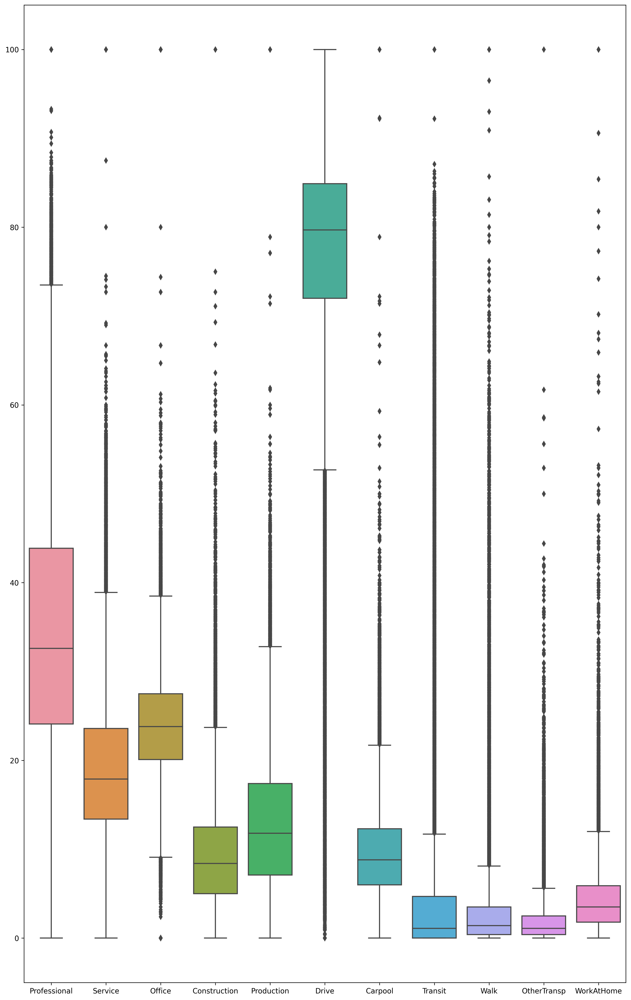

In [556]:
columns_5 = ['Professional', 'Service', 'Office', 'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome']
plot_boxplot(columns_5)
describe(columns_5)

There are again unrealistic 100% values for all the presented boxplots. Interestingly the are right skewed outliers for county regions with a very low number of people working in an office environment.

        MeanCommute
count  73052.000000
mean      25.667357
std        6.964881
min        1.200000
25%       20.800000
50%       25.000000
75%       29.800000
max       80.000000


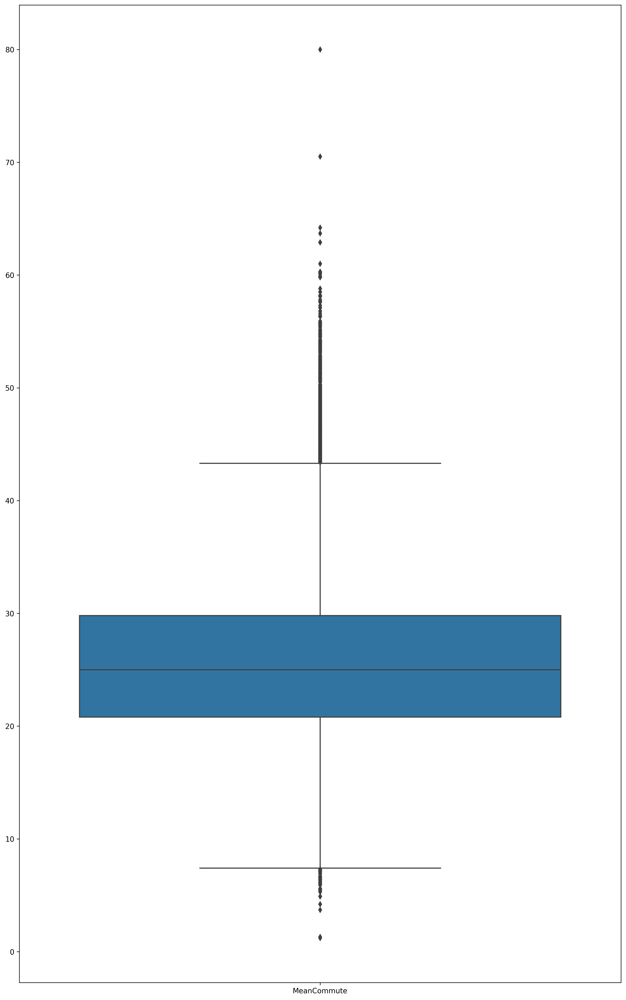

In [557]:
columns_6 = ['MeanCommute']
plot_boxplot(columns_6)
describe(columns_6)

There exist 2 unrealistic extreme outlier values in the upper part and one unrealistic very low outlier value.

## Handling Missing Values
(In the following task you can assume that every NAN entry in the dataframe is actually a missing value. This can paritally be justified by the fact that pandas did not have problems inferring the "proper" datatypes (e.g., numbers types as string would result in an object column) and your subsequent check of the data types. Therefore, you can use `df.isna()` as a proxy indicator for missing values.)

**e)** Simply filling missing entries is usually not a good idea. Therefore, you should first analyze the quantity of missing values and check for patterns of missing values.

To this end, compute the following statistics on missing values:
1) How many entries does the dataframe have? (To relate this to the number of entries missing)
2) How many missing values do we have?
3) How many rows have at least a single missing value?
4) Count the number of missing values per column.
5) Count the number of missing values per row and aggregate them - i.e., show the number of rows that suffer from x missing values.

What do you observe?

In [394]:
entries = df.size
print('1) Total no. of entries in Dataframe: ')
print(entries)
print()

print('2) Total no. of missing values in dataset:')
print(df.isna().sum().sum())
print()

print('3) Total no. of rows with at least 1 missing value:')
print((df.isna().sum(axis=1) > 0).sum())
print()

print('4) Number of missing values per column:')
print(df.isna().sum())
print()

print('5) Aggregate of missing values per row:')
null_in_rows = df.isna().sum(axis=1).tolist()
print(sum(null_in_rows))

1) Total no. of entries in Dataframe: 
2516034

2) Total no. of missing values in dataset:
22469

3) Total no. of rows with at least 1 missing value:
2008

4) Number of missing values per column:
State              0
County             0
TotalPop           0
Men              379
Women            361
Hispanic         690
White            690
Black            690
Native           690
Asian            690
Pacific          690
Citizen            0
Income          1100
IncomePerCap     740
Poverty          835
ChildPoverty    1118
Professional     807
Service          807
Office           807
Construction     807
Production       807
Drive            797
Carpool          797
Transit          797
Walk             797
OtherTransp      797
WorkAtHome       797
MeanCommute      949
Employed           0
PrivateWork      807
PublicWork       807
SelfEmployed     807
FamilyWork       807
Unemployment     802
dtype: int64

5) Aggregate of missing values per row:
22469


The above statistics show that there is no missing value in the `Population` column, which means that each city has a certain number of inhabitants.
But the columns `Men` and `Women` have missing values, which implies that in some cities there shouldn't exist either men or women, which is logically impossible.
So it could be that there is some mismatched data.

Most of the missing values are in the `ChildPoverty` column, from which we can conclude that no suitable data were available or collected.

**f)** We decide to **remove all rows from `df` where the total population is zero**. \
Given the preceding results, how do you evaluate this strategy? Try to motivate your argumentation by additional short analysis results (see hint for an inspiration).

*Hint: It might be interesting to have a look at the rows with zero population. Afterwards, you can provide some analysis results that show that your (potential) observation generalizes to all rows with zero population.*

In [558]:
zero_population = df.loc[df['TotalPop'] == 0]
zero_population

,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,...,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
CensusTract,,,,,,,,,,,,,,,,,,,,,
1003990000,Alabama,Baldwin,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1015981902,Alabama,Calhoun,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1015981903,Alabama,Calhoun,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1097990000,Alabama,Mobile,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1117980000,Alabama,Shelby,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72137990000,Puerto Rico,Toa Baja,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
72143990000,Puerto Rico,Vega Alta,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
72145990000,Puerto Rico,Vega Baja,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN


By having a look at the above data, it is clear that almost all the attributes have null/meaningless data where the 'Total Population' was zero.
Also, as in the above question, we claimed that it is not logically possible for a country to have either no man or women, so it is also justified here that such records have unrealistic values.

In [559]:
# deleting all such rows where the total_population = 0
df.drop(df.loc[df['TotalPop']==0].index, inplace=True)

In [560]:
print("Remaining missing values: ", df.isna().sum().sum())

Remaining missing values:  3839


## Imputing Missing Values

**g)** The previous analysis showed that there are missing values in the 'Men' and 'Women' columns.\
How would you impute these values? \
Motivate your approach and apply it to `df`.

*Hint: Do not forget about the semantics of the columns.*

In [561]:
# Using median to impute the missing values of column 'Men'
missing_col_men = ['Men']
for i in missing_col_men:
    df.loc[df.loc[:,i].isnull(),i]=df.loc[:,i].median()

# Using mean to impute the missing values of columns 'Women'
missing_col_women = ['Women']
for i in missing_col_women:
    df.loc[df.loc[:,i].isnull(),i]=df.loc[:,i].median()

In [400]:
print("Remaining missing values: ", df.isna().sum().sum())

Remaining missing values:  3099


The data provided is not perfectly symmetrical. Also, while plotting the box plot above in combination of different features we saw there the data was skewed. So it is better not to go with mean() imputation. We have decided to go with median imputation.

**h)** Finally, impute the remaining missing values in `df` using the knn-imputation method.

1) Before you impute the remaining missing values, you should improve the data semantics consistency by turning the columns 
    
        ['Men', 'Women', 'Citizen', 'Employed']
    
    into percentage scores as well. To this end, divide these values by the total population (i.e., 'TotalPop')

In [562]:
# Converting column 'Men' into percentage column
df['Men'] = (df['Men'] / df['TotalPop']) * 100

# Converting column 'Women' into percentage column
df['Women'] = (df['Women'] / df['TotalPop']) * 100

# Converting column 'Employed' into percentage column
df['Employed'] = (df['Employed'] / df['TotalPop']) * 100

# Converting column 'Citizen' into percentage column
df['Employed'] = (df['Citizen'] / df['TotalPop']) * 100

df.head(10)

,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,...,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
CensusTract,,,,,,,,,,,,,,,,,,,,,
1001020100,Alabama,Autauga,1948,48.254620,51.745380,0.9,87.4,7.7,0.3,0.6,...,0.5,2.3,2.1,25.0,77.156057,77.1,18.3,4.6,0.0,5.4
1001020200,Alabama,Autauga,2156,49.118738,50.881262,0.8,40.4,53.3,0.0,2.3,...,0.0,0.7,0.0,23.4,77.087199,77.0,16.9,6.1,0.0,13.3
1001020300,Alabama,Autauga,2968,45.956873,54.043127,0.0,74.5,18.6,0.5,1.4,...,0.0,0.0,2.5,19.6,78.672507,64.1,23.6,12.3,0.0,6.2
1001020400,Alabama,Autauga,4423,49.106941,50.893059,10.5,82.8,3.7,1.6,0.0,...,0.0,2.6,1.6,25.3,74.745648,75.7,21.2,3.1,0.0,10.8
1001020500,Alabama,Autauga,10763,45.730744,54.269256,0.7,68.5,24.8,0.0,3.8,...,0.0,0.6,0.9,24.8,71.225495,67.1,27.6,5.3,0.0,4.2
1001020600,Alabama,Autauga,3851,46.403532,53.596468,13.1,72.9,11.9,0.0,0.0,...,0.0,6.0,4.5,19.8,68.605557,79.4,14.7,5.8,0.0,10.9
1001020700,Alabama,Autauga,2761,43.824701,56.175299,3.8,74.5,19.7,0.0,0.0,...,0.0,0.0,0.0,20.0,74.610648,82.0,14.6,3.4,0.0,11.4
1001020801,Alabama,Autauga,3187,47.128961,52.871039,1.3,84.0,10.7,3.1,0.0,...,0.0,1.7,5.9,24.3,75.023533,78.1,14.8,7.1,0.0,8.2
1001020802,Alabama,Autauga,10915,50.261109,49.738891,1.4,89.5,8.4,0.0,0.0,...,0.0,0.0,1.3,29.4,71.259734,73.3,22.1,4.6,0.0,8.7


2) Impute the missing values using the knn-imputation method.
    To this end, apply the following steps:
        1) Create a working copy `df_tmp` of your dataframe.
        2) Drop the columns `['State', 'County']` from `df_tmp`. On the one hand, this makes the following steps easier because we only have to deal with numerical columns; on the other hand, an alternative one-hot encoding is also problematic as this will cause our feature dimensionality to explode!
        3) Normalize the data in `df_tmp` (e.g., Standard score normalization). If the features have very different scales, even though we are mostly using percentages, knn can become very biased.
        4) Impute the missing values considering five neighbors.
        5) Invert the transformation applied upfront to enable more meaningful and intuitive visualizations.
        6) Append the columns `['State', 'County']`
 
In the end, `df` should not contain missing values and have columns `['State', 'County']`.

*Hint: Be careful with the indices of your dataframes.*


In [563]:
# dropping category columns 'State' and 'County'
df_tmp = df.copy()
df_tmp.drop(['State', 'County'], axis=1, inplace=True)

In [564]:
# scaling
scaler = StandardScaler()
scaler.fit(df_tmp)
df_scaled = scaler.transform(df_tmp)

In [565]:
# impute missing values
df_imputed = KNNImputer(n_neighbors=5).fit_transform(df_scaled)

In [566]:
# invert scaling
df_inverted = pd.DataFrame(
    scaler.inverse_transform(df_imputed),
    columns=df_tmp.columns,
    index=df_tmp.index
)

In [567]:
# readd 'State' and 'County' columns
df = df_inverted.join(df[['State', 'County']])
df

,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Citizen,...,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,State,County
CensusTract,,,,,,,,,,,,,,,,,,,,,
1001020100,1948.0,48.254620,51.745380,0.9,87.4,7.700000e+00,0.3,0.6,0.0,1503.0,...,2.1,25.0,77.156057,77.1,18.3,4.6,0.0,5.4,Alabama,Autauga
1001020200,2156.0,49.118738,50.881262,0.8,40.4,5.330000e+01,0.0,2.3,0.0,1662.0,...,0.0,23.4,77.087199,77.0,16.9,6.1,0.0,13.3,Alabama,Autauga
1001020300,2968.0,45.956873,54.043127,0.0,74.5,1.860000e+01,0.5,1.4,0.3,2335.0,...,2.5,19.6,78.672507,64.1,23.6,12.3,0.0,6.2,Alabama,Autauga
1001020400,4423.0,49.106941,50.893059,10.5,82.8,3.700000e+00,1.6,0.0,0.0,3306.0,...,1.6,25.3,74.745648,75.7,21.2,3.1,0.0,10.8,Alabama,Autauga
1001020500,10763.0,45.730744,54.269256,0.7,68.5,2.480000e+01,0.0,3.8,0.0,7666.0,...,0.9,24.8,71.225495,67.1,27.6,5.3,0.0,4.2,Alabama,Autauga
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72153750501,6205.0,53.037873,46.962127,99.7,0.3,-1.776357e-15,0.0,0.0,0.0,4354.0,...,2.3,22.5,70.169218,64.7,31.3,3.9,0.0,21.3,Puerto Rico,Yauco
72153750502,2122.0,43.402451,56.597549,99.2,0.3,-1.776357e-15,0.0,0.5,0.0,1466.0,...,0.0,23.5,69.085768,64.0,32.6,3.3,0.0,22.4,Puerto Rico,Yauco
72153750503,2277.0,48.177426,51.822574,99.5,0.4,-1.776357e-15,0.0,0.2,0.0,1741.0,...,3.0,29.8,76.460255,58.2,32.3,9.5,0.0,23.3,Puerto Rico,Yauco


In [568]:
assert 'State' in df.columns
assert 'County' in df.columns
assert df.isna().sum().sum() == 0
assert df['Hispanic'].min() > -0.01
assert df['Hispanic'].max() < 101

## Data Integration

**i)** In the final preprocessing step, you should integrate one additional source of data into the preprocessed dataframe `df`. 
As the data has a natural geospatial dimension, you are going to endow each tract with its geographic coordinate.
To this end, load **coordinates.csv**. Integrate the two data sources exploiting the correspondence between 'CensusTract' and 'GEOID'.
Finally, drop the 'USPS' column.

In [569]:
df_coordinates = pd.read_csv('../data/coordinates.csv')
df = df.merge(df_coordinates, left_on='CensusTract', right_on='GEOID')
df.drop(['USPS'], axis=1, inplace=True)
df

,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Citizen,...,Unemployment,State,County,GEOID,ALAND,AWATER,ALAND_SQMI,AWATER_SQMI,INTPTLAT,INTPTLONG
0,1948.0,48.254620,51.745380,0.9,87.4,7.700000e+00,0.3,0.6,0.0,1503.0,...,5.4,Alabama,Autauga,1001020100,9809938,36312,3.788,0.014,32.481959,-86.491338
1,2156.0,49.118738,50.881262,0.8,40.4,5.330000e+01,0.0,2.3,0.0,1662.0,...,13.3,Alabama,Autauga,1001020200,3341886,5968,1.290,0.002,32.475758,-86.472468
2,2968.0,45.956873,54.043127,0.0,74.5,1.860000e+01,0.5,1.4,0.3,2335.0,...,6.2,Alabama,Autauga,1001020300,5349273,9054,2.065,0.003,32.474024,-86.459703
3,4423.0,49.106941,50.893059,10.5,82.8,3.700000e+00,1.6,0.0,0.0,3306.0,...,10.8,Alabama,Autauga,1001020400,6382707,16244,2.464,0.006,32.471030,-86.444835
4,10763.0,45.730744,54.269256,0.7,68.5,2.480000e+01,0.0,3.8,0.0,7666.0,...,4.2,Alabama,Autauga,1001020500,11399989,46159,4.402,0.018,32.458922,-86.421826
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73306,6205.0,53.037873,46.962127,99.7,0.3,-1.776357e-15,0.0,0.0,0.0,4354.0,...,21.3,Puerto Rico,Yauco,72153750501,1795741,0,0.693,0.000,18.031240,-66.867250
73307,2122.0,43.402451,56.597549,99.2,0.3,-1.776357e-15,0.0,0.5,0.0,1466.0,...,22.4,Puerto Rico,Yauco,72153750502,689929,0,0.266,0.000,18.024746,-66.860442
73308,2277.0,48.177426,51.822574,99.5,0.4,-1.776357e-15,0.0,0.2,0.0,1741.0,...,23.3,Puerto Rico,Yauco,72153750503,3322868,1952,1.283,0.001,18.023325,-66.874841
73309,5267.0,50.560091,49.439909,98.8,1.2,-1.776357e-15,0.0,0.0,0.0,3938.0,...,26.7,Puerto Rico,Yauco,72153750601,10987037,4527,4.242,0.002,18.017809,-66.839070


In [446]:
assert 'Men' in df.columns
assert 'County' in df.columns
assert 'INTPTLONG' in df.columns
assert 'INTPTLAT' in df.columns

# Q2 - Visualization (15 points)
In this task, you will analyze the data that you preprocessed in question 1 (**census_data.csv**). In particular you will analyze income-related aspects, using different means of visualization.

Start with the following preprocessed and integrated dataframe `df`. \
Note that it has a similar structure to the dataframe that you should obtain from the previous task, however, the values have been modified!

**Library usage:** This notebook imports a couple visualization libraries that have a significat overlap in terms of functionalities. Therefore, you are free to use any of these libraries (and those in the environment in general) to implement the following questions as long as your resulting plot compilies with the explicitly mentioned requirements.

In [4]:
df = pd.read_pickle('../data/df_vis.pkl')

**a)** Visualize two histograms for 'Income' and 'IncomePerCap' in a **single plot**. Compare the two distributions; what do you observe?

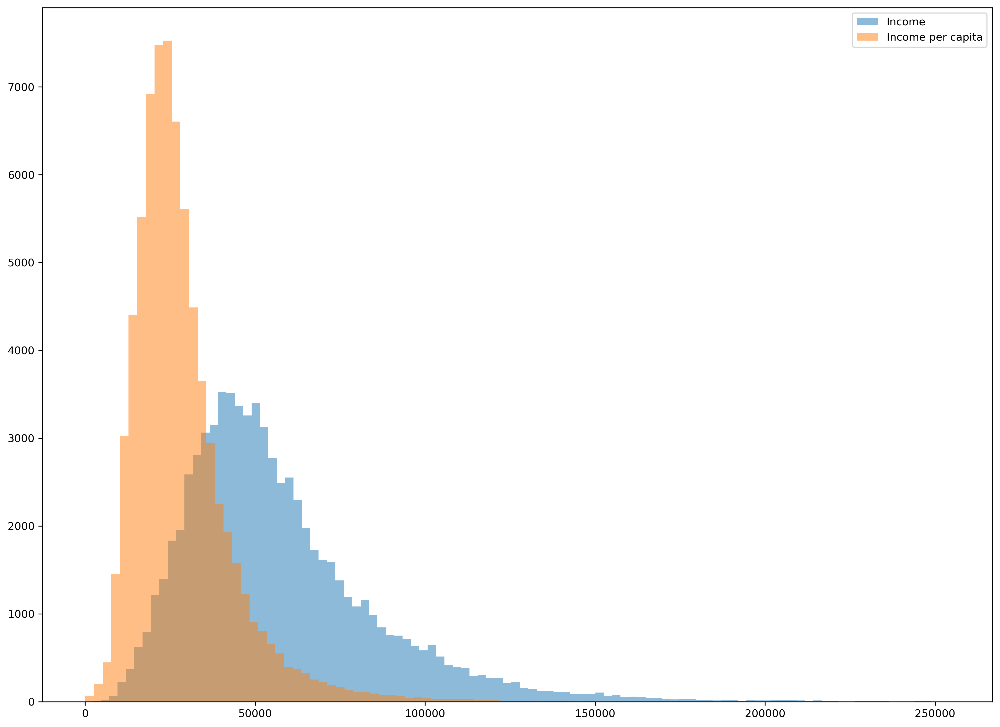

In [8]:
bins = 100
plt.figure(figsize=(16,12), dpi=300)
plt.hist(df['Income'], bins, alpha=0.5, label='Income')
plt.hist(df['IncomePerCap'], bins, alpha=0.5, label='Income per capita')
plt.legend()

From the two histograms, we can conclude that income per capita is lower than the (median household) income. A median household has more income available, since the income of all living in the household is included. In a household, one part of the household may earn a lot and the other part has little or no income. However, the part with lower income also has a larger median household income.

## Aggregation for Visualization Pruposes
**b)** As the data contains too many rows for per-row visualizations, you should aggregate the data further before creating more interesting visualizations.
The following function will do the job for your; however, why didn't we simply run `groupby(...).mean()` to get the results for the columns
specified in `l_col`?

In [5]:
def my_aggregation(df):
    l_col = ['Men', 'Women', 'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen', 'Income', 'IncomePerCap', 
             'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction', 'Production', 'Drive', 'Carpool', 
             'Transit', 'Walk', 'OtherTransp', 'WorkAtHome', 'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork', 'SelfEmployed', 
             'FamilyWork', 'Unemployment', 'INTPTLAT', 'INTPTLONG']
    df_tmp = df.copy()
    df_tmp.loc[idx[:, l_col]] = df_tmp.loc[idx[:, l_col]].mul(df_tmp['TotalPop'], axis=0)
    df_tmp = df_tmp.groupby(['State', 'County'], observed=True).sum()
    df_tmp.loc[idx[:, l_col]] = df_tmp.loc[idx[:, l_col]].div(df_tmp['TotalPop'], axis=0)
    
    return df_tmp


In [6]:
df = my_aggregation(df)

*Your markdown for your discussion.*

**c)** Next, you should create an overview over column correlations particularly consideirng high/medium/and low incomes.

1) Create a copy `df_plot` of the aggregated dataframe.

In [7]:
df_plot = df.copy()

2) Append a column 'IncomeClass' to `df_plot` containing the 'Income' categories based on the following inter-percentile ranges:
    - low' iff the income is less than the 33% income percentile
    - 'medium' if the income is between the 33% and 66% percentile, and 
    - 'high' iff the income is above the 66% percentile

In [8]:
df_plot['IncomeClass'] = pd.qcut(
    df_plot['Income'],
    q=[0, 1/3, 2/3, 1],
    labels=['low', 'medium', 'high']
)

df_plot.head()

TotalPop        Men      Women  Hispanic      White  \
State   County                                                              
Alabama Autauga   55253.997778  48.434887  51.568594  2.642546  75.856849   
        Baldwin  195170.839070  48.857848  51.134700  4.488181  83.002196   
        Barbour   26863.503003  53.855367  46.153208  4.713527  46.337913   
        Bibb      22677.565195  53.413070  46.561785  2.300174  74.439569   
        Blount    57809.081940  49.441549  50.587929  8.708269  88.048684   

                     Black    Native     Asian   Pacific    Citizen  ...  \
State   County                                                       ...   
Alabama Autauga  18.517057  0.429003  0.957841  0.018335  73.665310  ...   
        Baldwin   9.451327  0.575898  0.663861  0.000381  75.686041  ...   
        Barbour  46.648892  0.164449  0.425173  0.002802  76.931310  ...   
        Bibb     21.274928  0.456621  0.106137  0.000623  77.335504  ...   
        Blount    1.563644  0.287027  0.141126 -0.002487  73.447426  ...   

                 SelfEmployed  FamilyWork  Unemployment       ALAND  \
State   County                                                        
Alabama Autauga      5.422749   -0.002682      7.765676  1539589643   
        Baldwin      5.914107    0.363948      7.572219  4117584013   
        Barbour      7.155351    0.089266     17.533583  2291820706   
        Bibb         6.654708    0.394732      8.186001  1612481559   
        Blount       4.231243    0.353626      7.719260  1670041875   

                    AWATER  ALAND_SQMI  AWATER_SQMI   INTPTLAT  INTPTLONG  \
State   County                                                              
Alabama Autauga   25769317     594.440        9.948  32.501992 -86.509571   
        Baldwin  317781489    1589.807      122.696  30.552544 -87.766448   
        Barbour   50864677     884.877       19.640  31.861712 -85.328403   
        Bibb       9287974     622.583        3.587  33.033842 -87.150267   
        Blount    15077458     644.806        5.821  33.952978 -86.593007   

                 IncomeClass  
State   County                
Alabama Autauga         high  
        Baldwin         high  
        Barbour          low  
        Bibb             low  
        Blount        medium  

[5 rows x 39 columns]

3) Project the dataframe on the columns that contain percent values (for the sake of readability), that is:

        ['Men', 'Women', 'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific', 'Poverty', 'ChildPoverty', 
        'Professional', 'Service', 'Office', 'Construction', 'Production',
        'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome',
        'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork', 'SelfEmployed',
        'FamilyWork', 'Unemployment', 'IncomeClass']


In [9]:
df_plot.drop(
    [
        'TotalPop',  'Citizen', 'Income',
        'IncomePerCap', 'ALAND', 'AWATER',
        'ALAND_SQMI', 'AWATER_SQMI', 'INTPTLAT',
        'INTPTLONG'
    ],
    axis=1,
    inplace=True
)

4) Create a parallel coordinates diagram that uses the 'IncomeClass' for coloring the lines. Rotate the x-axis labels by 90° to make them easier to read.
Briefly discuss your results. Do you observe any correlations? Please explain.

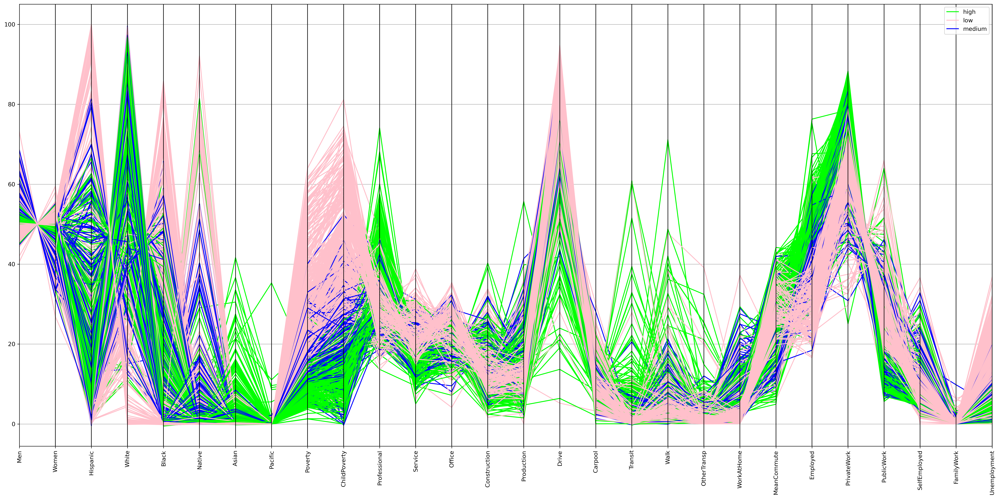

In [15]:
from pandas.plotting import parallel_coordinates

fig = plt.figure(figsize=(30,14), dpi=300)
parallel_coordinates(
    df_plot,
    'IncomeClass',
    color=['lime', 'pink', 'blue']
)
plt.xticks(rotation=90)
plt.show()

<AxesSubplot:>

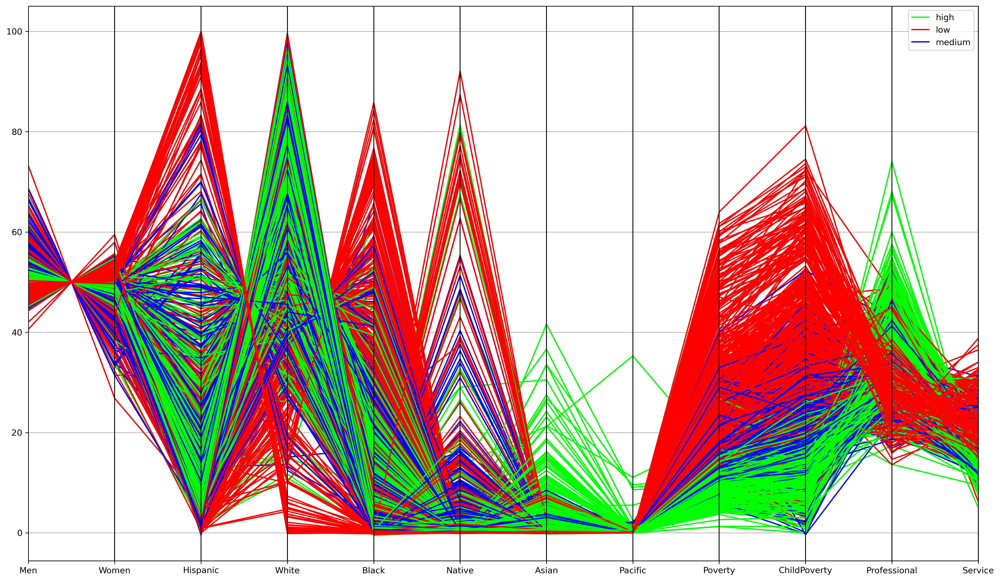

In [12]:
fig = plt.figure(figsize=(20,12), dpi=300)
first_half_df = df_plot.filter(['State','County','TotalPop','Men','Women', 'Hispanic','White','Black','Native','Asian','Pacific','Citizen', 'Income','IncomePerCap', 'Poverty','ChildPoverty', 'IncomeClass','Professional','Service'], axis=1)
parallel_coordinates(first_half_df, "IncomeClass", color=["lime", "red","blue"])

For features `Men`, `Hispanic`, `White`, `Black` and `Professional` there is a very high negative correlation. While for features `Women`, `Native`, `ChildPoverty` there is again a negative correlation. However, for features `Asian`, `Pacific` there is a positive correlation.

<AxesSubplot:>

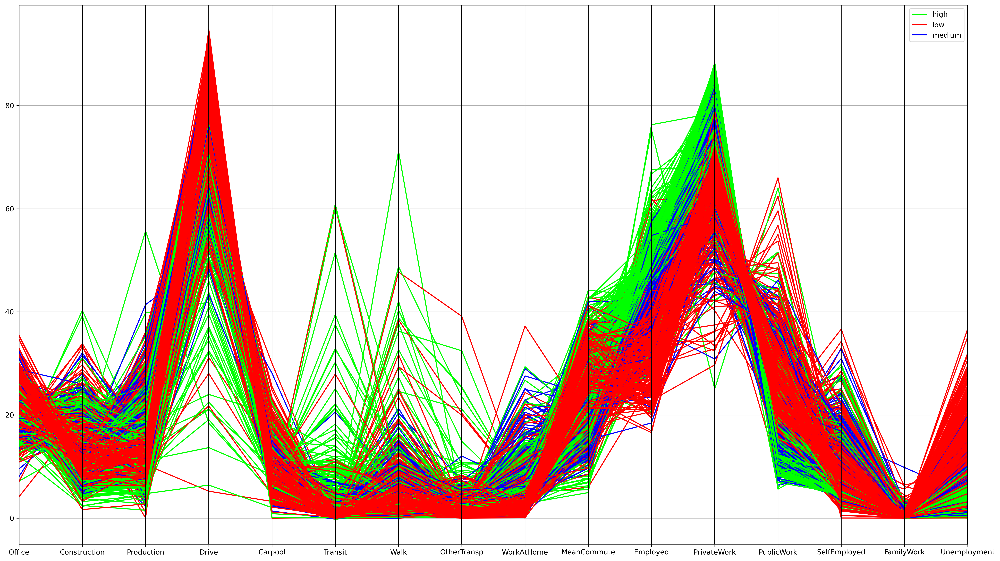

In [14]:
fig = plt.figure(figsize=(24,14), dpi=300)
second_half_df = df_plot.filter(['Office','Construction','Production','Drive','Carpool','Transit','Walk','OtherTransp', 'WorkAtHome','IncomeClass', 'MeanCommute','Employed', 'PrivateWork','PublicWork','SelfEmployed','FamilyWork','Unemployment'] , axis=1)
parallel_coordinates(second_half_df, "IncomeClass", color=["lime", "red","blue"])

For features `Office`, `Construction`, `MeanCommute`, `PrivateWork` there is a very high negative correlation. While for columns `Carpol`, `Transit`, `Walk`, `OtherTransp`, `WorkAtHome` there is again a negative correlation.

However, for features `Production`, `Drive`, `SelfEmployed` and family work there is a positive correlation and for features `Employed`, `PublicWork` there is mostly a positive.

## Avanced Visualization: Map

**d)** In this task, you are going to create an advanced visualization that exploits the geospatial nature of the data, that is, you will project the average 'Income' of each county and its population onto a map of the USA. \
You can use the following code to create a suitable map extend.

    ax.set_extent([-125, -66.5, 20, 50], ...)
        
Given this instance, plot one marker (e.g., circular marker) for each row in our aggregated dataset onto the map.
The color encoding should show the average 'Income' of the corresponding county, while the size should be chosen according to its population ('TotalPop'). If you want to modify the dataframe, create a **working copy** beforehand.

What do you observe?


In [496]:
import cartopy.feature as cfeature
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from sklearn.preprocessing import MaxAbsScaler

In [475]:
# calculate coloring
cmap = mpl.cm.get_cmap('viridis')
norm = mpl.colors.Normalize(vmin=0, vmax=df_plot['Income'].max())
csm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
np_col = cmap(norm(df_plot['Income']))

In [532]:
# calculate size
size_scaler = MaxAbsScaler()
np_size = 400 * size_scaler.fit_transform(df_plot[['TotalPop']])

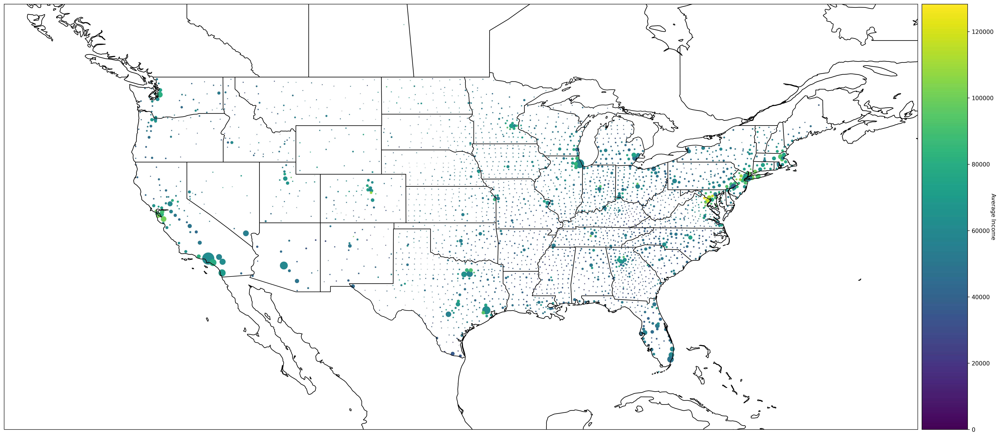

In [540]:
# set up the plot
proj = ccrs.PlateCarree()
f, ax = plt.subplots(1, 1, subplot_kw=dict(projection=proj), figsize=(30,30), dpi=320)

# add features
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.STATES)
ax.add_feature(cfeature.COASTLINE)

# show only USA
ax.set_extent(
    [-135, -60, 20, 55], # USA
    crs=proj
)

# scatter income markers
plt.scatter(
    x=df_plot['INTPTLONG'],
    y=df_plot['INTPTLAT'],
    color=np_col,
    s=np_size,
)

# add colorbar
divider = make_axes_locatable(ax)
ax_cb = divider.new_horizontal(size="5%", pad=0.1, axes_class=plt.Axes)
f.add_axes(ax_cb)
cbar = plt.colorbar(
    mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
    cax=ax_cb,
    orientation='vertical'
)
cbar.set_label('Average Income', rotation=270)

plt.savefig("test.png")
plt.show()

In the metropolitan area around New York in the northeast of america, the average income is very high. Often, the income is also greater in cities that are directly adjacent to large metropolitan areas. In slightly less densely populated areas near densely populated areas, the income is therefore higher. This can be seen for example at Chicago or Los Angeles. In general, the dataset has more data on the eastern side of America than the western side.

# Q3 - Frequent Itemsets and Association Rules (12 points)


## Frequent Itemsets

**a)** Carry out some preprocessing steps before starting the analysis:

1) Load the `customer_data.csv`.

2) Select 90% of the `customer_data` dataset by random sampling. Use the matriculation number of one of the group members as seed.

3) After completing this preprocessing step, export your final dataset as `customer_data_2.csv` and use it for the next steps of the assignment.

In [226]:
import pandas as pd
from mlxtend.frequent_patterns import apriori
import matplotlib.pyplot as plt

In [144]:
customer_data = pd.read_csv('../data/customer_data.csv').sample(frac=0.9, random_state=358025)
customer_data.to_csv('../output/customer_data_2.csv')

**b)** In this part, we want to get to know our customers by looking at the typical shared characteristics (e.g. "Married customers in their 40s like wine"). This would correspond to the itemset {Married, 40s, Wine}. 

1) Create a new dataframe called `customer_data_onehot` such that rows correspond to customers (as in the original data set) and columns correspond to the categories of each of the ten categorical attributes in the data. The new dataframe should only contain boolean values (True/False or 0/1s) such that the value in row $i$ and column $j$ is True (or 1) if and only if the attribute value corresponding to the column $j$ holds for the customer corresponding to row $i$. Display the dataframe.

*Hint: For example, for the attribute "Education" there are 5 possible categories: 'Graduation', 'PhD', 'Master', 'Basic', '2n Cycle'. Therefore, the new dataframe must contain one column for each of those attribute values.* 

In [225]:
customer_data_onehot = pd.get_dummies(customer_data)
customer_data_onehot.head()

,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Absurd,Marital_Status_Alone,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,...,Wine_Preference_No Wine,Wine_Preference_Wine,Fruit_Preference_Fruits,Fruit_Preference_No Fruits,Meat_Preference_Meat,Meat_Preference_No Meat,Sweets_Preference_No Sweets,Sweets_Preference_Sweets,Purchase_Place_Store,Purchase_Place_Web
1471,0,0,1,0,0,0,0,0,1,0,...,0,1,1,0,1,0,0,1,0,1
1008,0,0,0,0,1,0,0,0,0,0,...,1,0,0,1,0,1,1,0,1,0
2176,0,0,1,0,0,0,0,0,1,0,...,1,0,0,1,0,1,1,0,0,1
1341,0,0,1,0,0,0,0,0,1,0,...,0,1,1,0,1,0,0,1,1,0
1658,1,0,0,0,0,0,0,0,0,0,...,1,0,0,1,0,1,0,1,1,0


2) Use the apriori algorithm to find the frequent itemsets with **min_support = 0.3** from the `customer_data_onehot` dataframe. Show the frequent itemsets that contain at least **3** items.

*Hint: The apriori algorithm of mlxtend needs a dataframe containing only boolean values as input.*

In [223]:
frequent_itemsets = apriori(customer_data_onehot, min_support=0.3, use_colnames=True)

In [156]:
frequent_itemsets[frequent_itemsets['itemsets'].map(len) >= 3]

,support,itemsets
334,0.032096,"(Education_2n Cycle, Children_Children, Age_Gr..."
335,0.039619,"(Children_Children, Education_2n Cycle, Income..."
336,0.035105,"(Income_Class_Medium, Education_2n Cycle, Wine..."
337,0.032096,"(Education_2n Cycle, Income_Class_Medium, Meat..."
338,0.031595,"(Sweets_Preference_No Sweets, Education_2n Cyc..."
...,...,...
6150,0.051655,"(Wine_Preference_No Wine, Income_Class_Medium,..."
6151,0.031595,"(Income_Class_High, Children_No Children, Frui..."
6152,0.031595,"(Wine_Preference_No Wine, Income_Class_Medium,..."
6153,0.030090,"(Education_Graduation, Income_Class_Medium, Wi..."


**c)** In the following we will investigate the effect of using the apriori property when determining the candidates for the frequent itemsets.

1) Implement the following join- and prune steps of the Apriori algorithm: \
   **join function:** a function that, given the frequent itemsets of size k, generates and yields a list of itemsets of size k+1. Only itemsets that share exactly k elements should be merged. \
   **prune function:** Given the set of candidate itemsets of size k+1 and the set of frequent itemsets of size k, remove the candidate sets that contain an infrequent subset of size k and return the rest.

In [299]:
def join(L_k, k):
    C_k_plus_1 = set()

    for itemset1 in L_k:
        for itemset2 in L_k:
            if itemset1 == itemset2:
                break
            intersec = set(itemset1).intersection(itemset2)
            if len(intersec) == k-1:
                C_k_plus_1.add(frozenset(set(itemset1).union(set(itemset2))))

    return C_k_plus_1

In [309]:
def prune(C_k_plus_1, L_k):
    C_pruned = set()
    C_deleted = set()

    for candidate_set in C_k_plus_1:
        for (i, item) in enumerate(candidate_set):
            candidate_copy = set(candidate_set).copy()
            # remove one of the k+1 items, leaving a set of size k
            candidate_copy.remove(item)
            # check if itemset of size k is frequent
            if candidate_copy not in L_k:
                C_deleted.add(frozenset(candidate_set))
                break #stop exploring this candidate set
            if i == len(candidate_set)-1:
                # if we make it through all subsets of size k, we keep the current candidate set of size k+1
                C_pruned.add(frozenset(candidate_set))

    print(len(C_deleted))
    return C_pruned

2) To see the effect of the apriori property, compare the number of candidate itemsets of size 4 obtained with and without pruning from the itemsets of size three for different values for min_support. To this end, generate a list of tuples *(min_sup, C4_size, C4_size_pruned, L4_size)* as follows:

For $\textrm{min_support} \in [0.1,0.2,...,0.8,0.9,1]$, repeat:

1. Obtain all frequent itemsets of size three using the apriori algorithm.

2. Using the result from 1., generate all itemsets of size four by applying your **join function** $\rightarrow$ C4_size.

3. Prune the result from 2. using your **prune function** $\rightarrow$ C4_size_pruned.

4. Compute the frequent itemsets of size four by using the apriori algorithm $\rightarrow$ L4_size.

In [310]:
def obtain_stats(min_support_values):
    stats = []

    for value in min_support_values:
        frequent_value = apriori(customer_data_onehot, min_support=value, use_colnames=True)
        frequent_size3 = frequent_value[frequent_value['itemsets'].map(len) == 3]

        if not frequent_size3.empty:
            L3_size = frequent_size3['itemsets'].tolist()
            C4_size = join(L3_size, 3)
            C4_size_pruned = prune(C4_size, L3_size)
            L4_size = frequent_value[frequent_value['itemsets'].map(len) == 4]['itemsets'].tolist()
            stats.append((value, len(C4_size), len(C4_size_pruned), len(L4_size)))

    return stats

In [311]:
print("(min_sup, C4_size, C4_size_pruned, L4_size)")
stats = obtain_stats(np.arange(0.1, 1.1, 0.1))
stats

(min_sup, C4_size, C4_size_pruned, L4_size)
811
55
23
0


[(0.1, 1120, 309, 258),
 (0.2, 115, 60, 55),
 (0.30000000000000004, 39, 16, 9),
 (0.4, 0, 0, 0)]

3) Plot the number of candidate sets with and without pruning and the number of frequent itemsets of size four against the corresponding min_sup value. Interpret the plot.

In [312]:
min_sup_values, C4_sizes, C4_sizes_pruned, _ = zip(*stats)
x_axis = min_sup_values

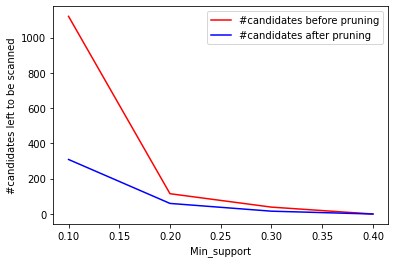

In [313]:
plt.plot(x_axis, C4_sizes, color='red', label='#candidates before pruning')
plt.plot(x_axis, C4_sizes_pruned, color='blue', label='#candidates after pruning')
plt.legend()
plt.xlabel('Min_support')
plt.ylabel('#candidates left to be scanned')
plt.show()

As the minimum support increases, the number of candidates that are pruned decreases, since the higher the min_support allows more itemsets to be interpreted as frequent.

d) Use the FP-Growth algorithm to obtain all frequent itemsets with **min_support = 0.3** from `customer_data_onehot`.

In [314]:
from mlxtend.frequent_patterns import fpgrowth

frequent_itemsets = fpgrowth(customer_data_onehot, min_support=0.3, use_colnames=True)
frequent_itemsets

,support,itemsets
0,0.711635,(Children_Children)
1,0.571715,(Wine_Preference_Wine)
2,0.518556,(Meat_Preference_Meat)
3,0.507021,(Education_Graduation)
4,0.460381,(Sweets_Preference_Sweets)
...,...,...
91,0.326981,"(Children_Children, Sweets_Preference_No Sweet..."
92,0.323972,"(Sweets_Preference_No Sweets, Fruit_Preference..."
93,0.312939,"(Children_Children, Sweets_Preference_No Sweet..."
94,0.305918,"(Children_Children, Sweets_Preference_No Sweet..."


## Association Rules

**d)** In the following, you should generate association rules from the frequent itemsets.

1) Using only the frequent itemsets with min_support=0.3, generate different association rules using minimum confidence equal to 0.6 as a metric. Show the association rules.

In [315]:
# your code
from mlxtend.frequent_patterns import association_rules as arule
confidence_filtered = arule(frequent_itemsets, metric="confidence", min_threshold=0.6)
confidence_filtered

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(Wine_Preference_Wine),(Purchase_Place_Store),0.571715,0.691575,0.368606,0.644737,0.932274,-0.026778,0.868160
1,(Wine_Preference_Wine),(Meat_Preference_Meat),0.571715,0.518556,0.483450,0.845614,1.630710,0.186984,3.118446
2,(Meat_Preference_Meat),(Wine_Preference_Wine),0.518556,0.571715,0.483450,0.932302,1.630710,0.186984,6.326379
3,(Meat_Preference_Meat),(Purchase_Place_Store),0.518556,0.691575,0.344534,0.664410,0.960721,-0.014086,0.919054
4,"(Purchase_Place_Store, Wine_Preference_Wine)",(Meat_Preference_Meat),0.368606,0.518556,0.328485,0.891156,1.718536,0.137343,4.423270
...,...,...,...,...,...,...,...,...,...
338,"(Purchase_Place_Store, Wine_Preference_No Wine)",(Meat_Preference_No Meat),0.322969,0.481444,0.306921,0.950311,1.973874,0.151429,10.435933
339,"(Purchase_Place_Store, Meat_Preference_No Meat)",(Wine_Preference_No Wine),0.347041,0.428285,0.306921,0.884393,2.064965,0.158288,4.945336
340,"(Wine_Preference_No Wine, Meat_Preference_No M...",(Purchase_Place_Store),0.393180,0.691575,0.306921,0.780612,1.128746,0.035008,1.405845
341,(Wine_Preference_No Wine),"(Purchase_Place_Store, Meat_Preference_No Meat)",0.428285,0.347041,0.306921,0.716628,2.064965,0.158288,2.304243


2) From the association rules obtained in task (d) 1), provide the three rules with the highest lift. Comment on them.

In [317]:
confidence_filtered.nlargest(3, 'lift')

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
88,"(Sweets_Preference_Sweets, Wine_Preference_Wine)","(Income_Class_High, Meat_Preference_Meat)",0.392678,0.358576,0.311434,0.793103,2.211816,0.170629,3.100217
91,"(Income_Class_High, Meat_Preference_Meat)","(Sweets_Preference_Sweets, Wine_Preference_Wine)",0.358576,0.392678,0.311434,0.868531,2.211816,0.170629,4.619523
110,"(Income_Class_High, Meat_Preference_Meat)","(Wine_Preference_Wine, Fruit_Preference_Fruits)",0.358576,0.389168,0.306419,0.854545,2.195829,0.166873,4.199473


Wine is often consumed with a dinner of meat to go with it, so it makes sense that when a customer purchases Sweets and Wine, they are also purchasing meat. Meat and wine are affluent products. This explains the high income. Fruits are often consumed with it.

# Q4 - Text Mining (15 points)
In this question, you will use the scripts of some Harry Potter movies. First, you will try to predict the character given a line in the script. Afterwards, using N-grams, you will generate sentences for some of the characters.

**a)** In this part, you will preprocess and reconstruct the data to make it suitable for the following tasks.

1) Load each of the datasets <b>hp_1.csv</b>, <b>hp_2.csv</b>, and <b>hp_3.csv</b> into its own dataframe and show the set of characters (here: a fictional character) appearing in each dataset.

In [92]:
import pandas as pd
from sklearn.model_selection import train_test_split

import nltk
nltk.download("stopwords")
nltk.download('wordnet')
nltk.download('omw-1.4')

from nltk.tokenize import sent_tokenize
from nltk.stem import PorterStemmer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from nltk.stem.wordnet import WordNetLemmatizer

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/miguelfranken/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/miguelfranken/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /Users/miguelfranken/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


In [2]:
df_1 = pd.read_csv('../data/hp_1.csv')
df_2 = pd.read_csv('../data/hp_2.csv')
df_3 = pd.read_csv('../data/hp_3.csv')

In [3]:
df_1['Character'] = df_1['Character'].str.lower()
df_1['Character'].unique()

array(['dumbledore', 'mcgonagall', 'hagrid', 'petunia', 'dudley',
       'vernon', 'harry', 'snake', 'someone', 'barkeep\xa0tom', 'man',
       'witch', 'quirrell', 'boy', 'goblin', 'griphook', 'ollivander',
       'trainmaster', 'mrs. weasley', 'george', 'fred', 'ginny', 'ron',
       'woman', 'hermione', 'neville', 'malfoy', 'whispers',
       'sorting hat', 'seamus', 'percy', 'sir nicholas', 'girl',
       'man in paint', 'fat lady', 'snape', 'dean', 'madam hooch',
       'class', 'harry ', 'fred  ', 'ron  ', 'george  ', 'harry  ',
       'hermione  ', 'ron ', 'hermione ', 'filch', 'all  ', 'oliver ',
       'oliver  ', 'flitwick', 'draco  ', 'flitwick  ', 'seamus  ',
       'girl  ', 'boy  ', 'percy  ', 'mcgonagall ', 'ron and harry',
       'mcgonagall  ', 'quirrell  ', 'snape  ', 'oiiver  ', 'lee jordan',
       'hagrid ', 'gryffindors  ', 'flint  ', 'crowd  ', 'flint',
       'hagrid  ', 'man  ', 'lee  jordan', 'madam hooch ', 'quirrell ',
       'filch  ', 'dumbledore  ', 'herm

In [4]:
df_2['Character'] = df_2['Character'].str.lower()
df_2['Character'].unique()

array(['harry ', 'vernon', 'harry', 'petunia', 'uncle vernon', 'dudley',
       'aunt petunia', 'dobby', 'dobby ', 'uncle vernon ', 'ron',
       'george', 'fred', 'george ', 'aunt\xa0petunia\xa0& dudley  ',
       'dudley ', 'ron ', 'fred ', 'mrs. weasley ', 'ginny ',
       'mr. weasley', 'fred, george, ron  ', 'fred, george, ron, harry  ',
       'percy ', 'mr. borgin', 'lucius malfoy', 'draco', 'lucius malfoy ',
       'witch', 'hagrid', 'hermione', 'man', 'photographer', 'lockhart',
       'mrs. weasley', 'trainmaster', 'harry and ron', 'filch', 'snape',
       'dumbledore', 'mcgonagall', 'professor sprout', 'class', 'seamus',
       'penelope clearwater', 'sir nicholas', 'colin', 'dean', 'seamus ',
       'neville', 'gilderoy lockhart', 'cornish pixies', 'wood', 'flint',
       'voice', 'boy', 'picture', 'lee jordan', 'slytherins',
       'madam pomfrey', 'moaning myrtle', 'justin finch-fletchley',
       'sorting hat', 'crabbe', 'percy', 'diary', 'tom riddle',
       'harry-ron-

In [5]:
df_3['Character'] = df_3['Character'].str.lower()
df_3['Character'].unique()

array(['harry', 'aunt petunia', 'uncle vernon', 'aunt marge',
       'stan shunpike', '\nstan shunpike', 'shrunken head', 'tom',
       'fudge', 'vendor', 'housekeeper', 'ron', 'hermione', 'george',
       'fred', 'mrs. weasley', 'mr. weasley', 'lupin', 'dumbledore',
       'draco', 'seamus', 'fat lady', 'dean', 'trelawney', 'neville',
       'bem', 'hagrid', 'pansy parkinson', 'boy', 'class', 'parvati',
       'mcgonagall', 'filch', 'percy', 'ginny', 'teacher', 'snape',
       'crowd', 'man', 'fred & george', 'witch', 'crabbe',
       'madam rosmerta', 'shrunken head 1', 'shrunken head 2', 'voice',
       'goyle', 'sirius', 'pettigrew', 'boy 1', 'boy 2'], dtype=object)

2) Merge the three datasets into a single dataframe called `hp_df` that comprises only the lines spoken from one of the four characters *Harry, Hermione, Dumbledore, and Snape*. Your new dataframe must contain two columns: one for the (four) characters and the other for the lines. You can name those columns "Character" and "Sentence" as in the original data. \
    Make sure that `hp_df` contains a single unique spelling for each of the characters. \
    Make sure that `hp_df` includes all lines (here: script lines) of a character even if this character is spelled slightly differently (e.g., Dumbledore or dumbledore) in the original dataset. \
    Show the first few lines of your dataframe.
    
*Hint: Be aware of white space characters!*

In [6]:
df_1_main = df_1[
    (df_1['Character'] == 'dumbledore') |
    (df_1['Character'] == 'harry') |
    (df_1['Character'] == 'hermione') |
    (df_1['Character'] == 'snape')
]

df_2_main = df_2[
    (df_2['Character'] == 'dumbledore') |
    (df_2['Character'] == 'harry') |
    (df_2['Character'] == 'hermione') |
    (df_2['Character'] == 'snape')
]

df_3_main = df_3[
    (df_3['Character'] == 'dumbledore') |
    (df_3['Character'] == 'harry') |
    (df_3['Character'] == 'hermione') |
    (df_3['Character'] == 'snape')
]

In [7]:
hp_df = pd.concat([df_1_main, df_2_main, df_3_main])
hp_df.head()

,Character,Sentence
0,dumbledore,"I should've known that you would be here, Prof..."
3,dumbledore,"I'm afraid so, professor."
4,dumbledore,The good and the bad.
6,dumbledore,Hagrid is bringing him.
8,dumbledore,"Ah, Professor, I would trust Hagrid with my life."


3) Create the `hp_sampled` dataset which includes 90% of the `hp_df` data. Use the matriculation number of one of the group members as seed. Export the sampled dataset. 

In [9]:
hp_sampled = hp_df.sample(frac=0.9, random_state=358025)
hp_sampled.to_csv('../output/hp_sampled.csv')

**b)** In this part, you are going to train a classifier that, given a line from the script, predicts the character. For each character, the data contains many sentences belonging to that character. Note that sometimes the "Sentence" column in the original dataset contains more than one sentence. The set of sentences for each character should be seen as the set of example documents belonging to that character (the class). Each individual sentence is a single document. The whole corpus consists of all the individual sentences.

1) Create a new dataframe called `hp_processed` from the dataframe `hp_sampled` such that the new dataframe contains again the columns "Character" and "Sentence", but every entry in the "Sentence" column must be a single sentence. Display the shape of the dataframe and compare it to the shape of `hp_sampled`.

In [10]:
print("Shape of hp_sampled: ", hp_sampled.shape)

Shape of hp_sampled:  (1382, 2)


In [11]:
df = hp_sampled.copy()
df['Sentence'] = (df.apply(lambda x: sent_tokenize(x['Sentence']), axis=1))
df.head()

,Character,Sentence
1096,dumbledore,[They are true.]
1292,harry,[Okay.]
639,harry,"[Dumbledore and the others, I mean?]"
966,harry,[Knight to E-5.]
1549,harry,[Not as long as those who remain are loyal to ...


In [12]:
hp_processed = df.explode("Sentence")
hp_processed.head()

,Character,Sentence
1096,dumbledore,They are true.
1292,harry,Okay.
639,harry,"Dumbledore and the others, I mean?"
966,harry,Knight to E-5.
1549,harry,Not as long as those who remain are loyal to him.


In [13]:
print("Shape of hp_processed: ", hp_processed.shape)

Shape of hp_processed:  (1570, 2)


2) Split the preprocessed data `hp_processed` into training (80%) and test (20%) data preserving the distribution based on "Character".

In [14]:
hp_train, hp_test = train_test_split(
    hp_processed,
    random_state=358025,
    test_size=.2,
    stratify=hp_processed.Character
)

3) Preprocess the training and test corpus (to lowercase, no punctuation, tokenization, lemmatization, and stopword removal) and obtain a boolean document-term matrix (i.e, each row in the matrix contains only 1s and 0s depending on whether a particular word appears in a sentence or not). Train a logistic classifier on the training corpus with the character as target feature. Use the classifier to predict the character of the sentences in the test corpus and show its accuracy on the test corpus. Comment on the result.

In [96]:
tokenizer = RegexpTokenizer(r"\w+")
stop_list = stopwords.words("english")

In [97]:
# to lowercase, no punctuation, tokenization, lemmatization, and stopword removal
class LemmaTokenizer(object):
    def __call__(self, sentence):
        tokenized = tokenizer.tokenize(sentence)
        filtered = [word.lower() for word in tokenized if word.lower() not in stop_list]
        lemmatized = [WordNetLemmatizer().lemmatize(word) for word in filtered]
        return lemmatized

vectorizer_hp = CountVectorizer(binary=True, analyzer=LemmaTokenizer())
classifier_hp = LogisticRegression()

hp_pipeline = Pipeline([('vect', vectorizer_hp), ('logistic', classifier_hp)])
hp_classify = hp_pipeline.fit(hp_train['Sentence'], hp_train['Character'])

# prediction on the test data
accuracy = hp_classify.score(hp_test['Sentence'], hp_test['Character'])
print('BoW - Classifier accuracy on test set:', accuracy)

BoW - Classifier accuracy on test set: 0.5955414012738853


In [138]:
from sklearn.dummy import DummyClassifier
import numpy as np
dummy_clf = DummyClassifier(strategy='stratified')
dummy_clf.fit(np.zeros(len(hp_train['Character'])), hp_train['Character'])
score = dummy_clf.score(np.zeros(len(hp_test['Character'])), hp_test['Character'])
print("Dummy Score: ", score)

Dummy Score:  0.39171974522292996


We have been able to train a model that can decide with an approximate accuracy of 60% on the test set whether a certain sentence was said by one of the four characters. In order to make statements about how efficient our model is, we trained a dummy model that makes a randomized decision based on the class distribution (i.e. the amount of sentences each character says). This models has an accuracy of approximately 40% which is far less than the more sophisticated model.

4) Next, you are going to perform the same predicting task based on doc2vec.

1. Preprocess the training corpus (to lowercase, no punctuation, tokenization, lemmatization, and stopword removal). 
2. Create a doc2vec model to reduce the dimension of the document vector. Choose a vector size 4-8 and ignore all words whose count is lower than 3.
3. Train the doc2vec model on the training data (thus creating an embedding).
4. Use the created embedding to convert the training set to a set of document vectors.
5. Train a logistic classifier on the train data with the character as target feature.
6. Show the accuracy of prediction on the test data and comment on it.

In [139]:
def preprocess(sentences):
    corpus = []
    for sentence in sentences:
        tokenized = tokenizer.tokenize(sentence)
        filtered = [word.lower() for word in tokenized if word.lower() not in stop_list]
        lemmatized = [WordNetLemmatizer().lemmatize(word) for word in filtered]
        corpus.append(lemmatized)
    return corpus


In [99]:
corpus_train = preprocess(hp_train['Sentence'].tolist())
corpus_test = preprocess(hp_test['Sentence'].tolist())

In [100]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

# create TaggedDocument
tagged_docs_train = [TaggedDocument(doc, [i]) for i, doc in enumerate(corpus_train)]

# determining parameters of the model
model = Doc2Vec(vector_size=4, min_count=3)

# building the vocabulary
model.build_vocab(tagged_docs_train)

training_examples = model.corpus_count

# document embedding, train the model on the training examples (docs)
model.train(corpus_iterable=tagged_docs_train, total_examples=training_examples, epochs=100)

In [101]:
#classifier
from sklearn.linear_model import LogisticRegression

print('Creating classifier')

classifier_doc2vec = LogisticRegression()

train_vectors = [model.infer_vector(doc) for doc in corpus_train]
train_target = hp_train['Character']

test_vectors = [model.infer_vector(doc) for doc in corpus_test]
test_target = hp_test['Character']

classifier_doc2vec = classifier_doc2vec.fit(X=train_vectors, y=train_target)

print('Evaluating model on test set')

print('doc2vec - Classifier accuracy on test set:')
print(classifier_doc2vec.score(test_vectors, test_target))

Creating classifier
Evaluating model on test set
doc2vec - Classifier accuracy on test set:
0.5477707006369427


**c)** For the following tasks use the `hp_processed` (the data before splitting into training and test data).

1) For each character, create a list containing all sentences of that character.
    For each character separately, build a bigram language model using MLE. Do not perform stemming and stopword removal for this task, but apply other preprocessing steps such as to lowercase, no punctuation, and tokenization. Use both right and left padding.

In [110]:
dumbledore_sentences = hp_processed[hp_processed['Character'] == 'dumbledore']['Sentence'].values.tolist()

harry_sentences = hp_processed[hp_processed['Character'] == 'harry']['Sentence'].values.tolist()

snape_sentences = hp_processed[hp_processed['Character'] == 'snape']['Sentence'].values.tolist()

hermione_sentences = hp_processed[hp_processed['Character'] == 'hermione']['Sentence'].values.tolist()

In [112]:
# all to lowercase, no punctuation and tokenization
def preprocess(texts):
    preprocessed_texts = []
    for text in texts:
        lower_text = text.lower()
        tokenized_word = tokenizer.tokenize(lower_text)
        preprocessed_texts.append(tokenized_word)
    return preprocessed_texts

dumbledore_sentences_preprocessed = preprocess(dumbledore_sentences)
harry_sentences_preprocessed = preprocess(harry_sentences)
snape_sentences_preprocessed = preprocess(snape_sentences)
hermione_sentences_preprocessed = preprocess(hermione_sentences)

In [114]:
from nltk.lm import MLE
from nltk.lm.preprocessing import padded_everygram_pipeline

def get_model(texts, order=2):
    lm = MLE(order)
    train, vocab = padded_everygram_pipeline(order=order, text=texts)
    lm.fit(train, vocab)
    return lm

lm_bigram_dumbledore = get_model(dumbledore_sentences_preprocessed)
lm_bigram_harry = get_model(harry_sentences_preprocessed)
lm_bigram_snape = get_model(snape_sentences_preprocessed)
lm_bigram_hermione = get_model(hermione_sentences_preprocessed)

2) For each character, use the created language model to generate a sentence of ten words. Display the sentences.

In [116]:
num_words = 10

In [118]:
print(lm_bigram_dumbledore.generate(num_words))
print(lm_bigram_harry.generate(num_words))
print(lm_bigram_snape.generate(num_words))
print(lm_bigram_hermione.generate(num_words))

['taken', 'by', 'means', 'that', 's', 'true', 'is', 'there', '</s>', 'gryffindor']
['stop', 'it', 'this', '</s>', 'what', '</s>', 'tried', 'to', 'platform', '9']
['these', 'grounds', 'since', 'before', 'you', 'take', 'pride', 'in', 'a', 'rather']
['if', 'you', '</s>', 'can', 't', 'you', 've', 'got', '</s>', 'my']


3) Build a 4-gram model with the same data as in the previous task. Use both right and left padding.

In [ ]:
lm_quadgram_dumbledore = get_model(dumbledore_sentences_preprocessed, 4)
lm_quadgram_harry = get_model(harry_sentences_preprocessed, 4)
lm_quadgram_snape = get_model(snape_sentences_preprocessed, 4)
lm_quadgram_hermione = get_model(hermione_sentences_preprocessed, 4)

4) For each character, use the created 4-gram language model to generate a sentence of ten words. Display the sentences.

In [120]:
print(lm_bigram_dumbledore.generate(num_words))
print(lm_bigram_harry.generate(num_words))
print(lm_bigram_snape.generate(num_words))
print(lm_bigram_hermione.generate(num_words))

['i', 'was', 'taken', 'by', 'none', 'other', 'than', 'our', 'excellent', 'feast']
['it', '</s>', 'home', '</s>', 'know', 'who', 'meet', 'you', 're', 'not']
['it', '</s>', '</s>', '<s>', 'that', 'you', 'silly', 'girl', 'has', 'come']
['been', 'his', 'friend', '</s>', '<s>', 'harry', '</s>', 's', 'been', 'here']


5) Compare the sentences generated by the bigram model with the sentences generated by the 4-gram model.

Higher `n` generally provide better outputs than lower `n` in n-grams but as `n` is increased the complexity of the computation time also increases. Also, the amount of data available decreases with higher `n` so that there will fewer next words available. This can also be seen when comparing the generated texts for our lovely characters. It should be considered in general to use a higher `n` if the results look good, else a bigram is better. In our case we would choose the bigram.

# Q5 - Process Mining (23 points)

In this task, we consider a simulated process of students that participate in an online course.
The course comprises 6 batches of lecture material as well as a mandatory assignment to be delivered in two parts. (Note that in this process, it is not required to achieve a certain score in the assignment in order to be admitted to the exam.)

While there are strict deadlines for the assignment and the exam, there is only a recommended schedule for the lecture material (i.e., consume material in order).

The system logs for every student, among other activities, when he downloads a certain lecture material batch. 

## Loading the Data and Basic Statistics

**a)** Load the data **log.csv** and create a PM4Py event log. In doing so, use the following column mapping:
 - 'Activity' is the activity key
 - 'Student' is the case ID
 - 'Timestamp' is the timestamp

In [1]:
import pandas as pd

In [2]:
from pm4py.objects.conversion.log import converter as log_converter
import pm4py

In [154]:
df = pd.read_csv('../data/log.csv')
df = pm4py.format_dataframe(df, case_id='Student', activity_key='Activity', timestamp_key='Timestamp')
log = log_converter.apply(df)

**b)** Compute the following basic information:
- Number of events
- Number of cases
- Earliest timestamp
- Latest timestamp
- Number of trace variants

In [131]:
from pm4py.algo.filtering.log.variants import variants_filter

variants = variants_filter.get_variants(log)

print('Number of events:', df['concept:name'].nunique())
print('Number of cases:', df['case:concept:name'].nunique())
print('Earliest timestamp:', df['time:timestamp'].min())
print('Latest timestamp:', df['time:timestamp'].max())
print('Number of trace variants:', len(variants))

Number of events: 12
Number of cases: 2000
Earliest timestamp: 2021-09-15 00:18:18+00:00
Latest timestamp: 2022-02-20 14:00:00+00:00
Number of trace variants: 432


**c)** Usually, it is insightful to have a look at the distribution of the variants in terms of how often a certain variant is present in the log.
Therefore, create a **scatter plot** that shows the distribution of the variants as follows:
- x-axis: The variants (in ascending order of their support)
- y-axis: Frequency of the variant in the log (total or relative)

/var/folders/xs/0tphpd6d0pv3cq893nvjgjbh0000gn/T/ipykernel_49395/3920900610.py:19: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  ax.axes.xaxis.set_ticks([])


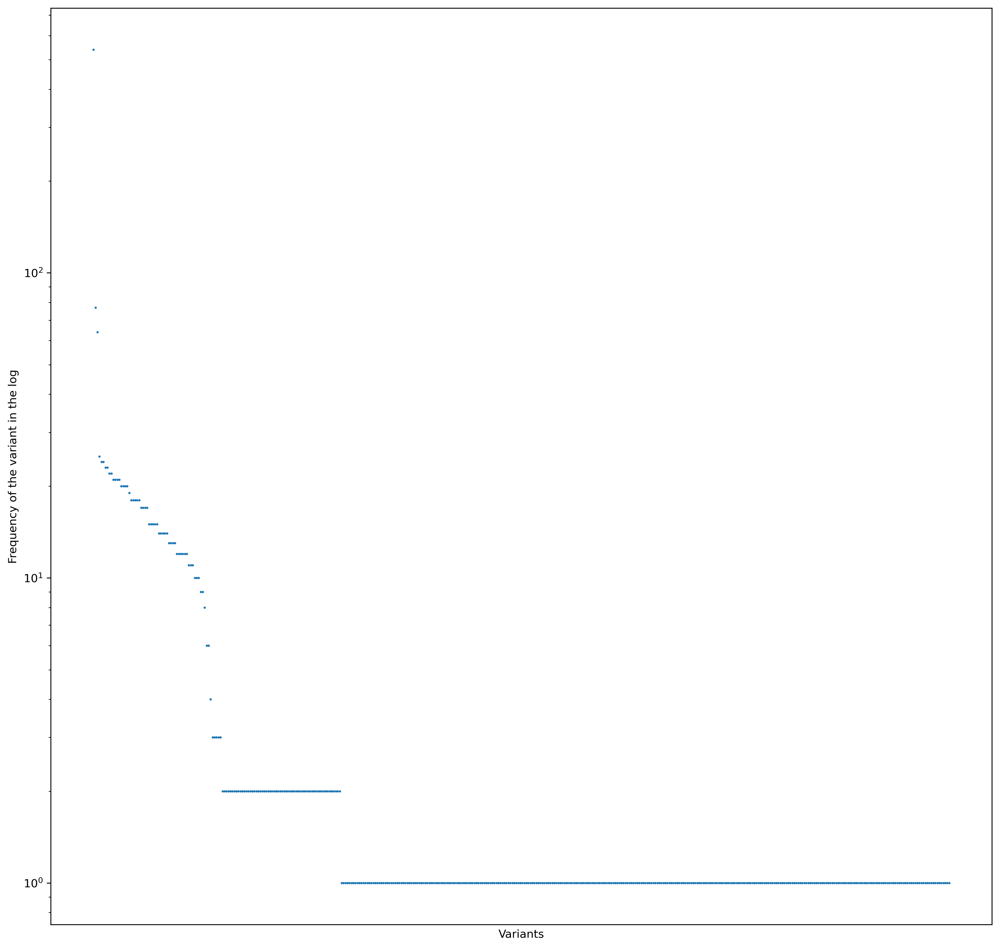

In [35]:
from pm4py.statistics.traces.generic.log import case_statistics
from operator import itemgetter

variants_count = case_statistics.get_variant_statistics(log)
variants_count = sorted(variants_count, key=lambda x: x['count'], reverse=True)
variants = list(map(itemgetter('variant'), variants_count))
count = list(map(itemgetter('count'), variants_count))

# plot scatter plot
_, ax = plt.subplots(1, figsize=(15,15), dpi=300)
ax.scatter(
    x=variants,
    y=count,
    s=1
)
plt.xlabel('Variants')
plt.ylabel('Frequency of the variant in the log')
ax.axes.xaxis.set_ticks([])
ax.set_yscale('log')
plt.savefig('variants-count.png')
plt.show()

**d)** While the variant distribution shows potential standard process executions in terms of the activity ordering, the distribution of the case durations shows the typical timeframe of cases.
Create a histogram plot over the case durations. For the sake of readability, make sure that the x-axis labels (in this case the case durations) have an easily readable format, that is, your x-axis labels should look like this:

In [ ]:
import matplotlib
from pm4py.statistics.traces.generic.log import case_statistics

In [50]:
# get case durations in seconds
all_case_durations = case_statistics.get_all_case_durations(log, parameters={
    case_statistics.Parameters.TIMESTAMP_KEY: "time:timestamp"
})

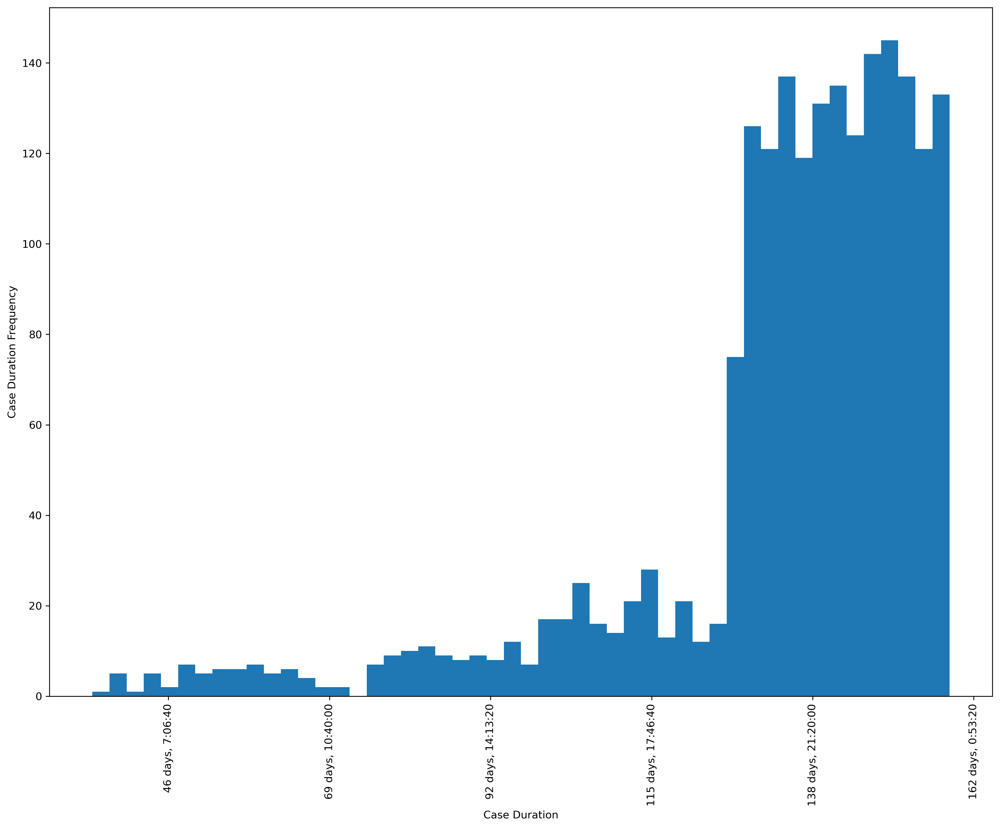

In [73]:
# transform x-axis tick labels from duration (in seconds) to a more readable format
def timeTicks(seconds, _):
    return str(datetime.timedelta(seconds=seconds))

fig = plt.figure(figsize=(16,12), dpi=300)
ax = fig.add_subplot(111)
plt.xticks(rotation=90)

formatter = matplotlib.ticker.FuncFormatter(timeTicks)
ax.xaxis.set_major_formatter(formatter)

ax.hist(all_case_durations, bins=50)

plt.ylabel('Case Duration Frequency')
plt.xlabel('Case Duration')

plt.savefig('duration-histogram.png')
plt.show()

## Discovery and Conformance Checking
Next, you are going to discover process models for different perspectives on the process. Moreover, you will evaluate how well the process models can represent the behavior present in the log (i.e., the fitness of the models).

### Filtering

**e)** Before discovering models, create three addtional perspectives onto the process by creating three additional event log from the log loaded in a):

1. Log containing only 30% of the most frequent traces (**log_varaint03**)
2. Log containing only 50% of the most frequent traces (**log_varaint05**)
3. Log containing only students that take the exam, that is, cases that end with 'Exam' (**log_exam**)

In [74]:
from pm4py.algo.filtering.log.variants import variants_filter
from pm4py.algo.filtering.log.end_activities import end_activities_filter

log_variant03 = variants_filter.filter_log_variants_percentage(log, percentage=0.3)
log_variant05 = variants_filter.filter_log_variants_percentage(log, percentage=0.5)

end_activities = end_activities_filter.get_end_activities(log)
log_exam = end_activities_filter.apply(log, ["Exam"])

### Inductive Miner and Replay Fitness

**f)** To get a better understanding of the processes in our four event logs (base log + three additional logs), create processes models using the **Inductive Miner**.
Concretely, for each of the 4 event logs, create two process models using the Inductive Miner with noise threshold **0 and 0.2**. Moreover, to access how well the model presents the logged behavior, apply conformance checking in terms of token-based replay to the model and the log from which it has been mined. Visualize each model as a process tree and as the corresponding Petri net.

In total, your cells should output 8 conformance scores, 8 process trees, and 8 Petri nets (for each log + noise threshold combination). Make sure that it is clear which model and conformance score belongs to log and parameter configuration.

**Describe your results**. How well do the models fit and, in particular, how do the models for
- log_variant05 and log (base log)
- log_variant05 and log_variant03
- log base and log_exam

differ in terms of the behavior that they allow?


In [101]:
from pm4py.objects.conversion.process_tree import converter as pt_converter
from pm4py.visualization.process_tree import visualizer as pt_visualizer
from pm4py.algo.evaluation.replay_fitness import algorithm as replay_fitness_evaluator

In [82]:
# helper that plots the given process tree
def visualize_process_tree(tree):
    gviz = pt_visualizer.apply(tree, parameters={
        pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"
    })
    pt_visualizer.view(gviz)

In [100]:
# helper that plots the given petri net
def visualize_petri_net(petri):
    pm4py.view_petri_net(*petri, format='png')

In [102]:
# conformance checking
def calculate_fitness(plog, petri):
    fitness_arr = replay_fitness_evaluator.apply(
        plog,
        *petri,
        variant=replay_fitness_evaluator.Variants.TOKEN_BASED
    )
    return fitness_arr['perc_fit_traces']

In [120]:
# print fitness, show process tree, show petri net
def generate_output(plog, noise_threshold=0):
    proc_tree = pm4py.discover_process_tree_inductive(plog, noise_threshold=noise_threshold)
    petri_net = pt_converter.apply(proc_tree)
    fitness = calculate_fitness(plog, petri_net)
    print("Fitness score:", fitness)
    visualize_process_tree(proc_tree)
    visualize_petri_net(petri_net)
    return proc_tree, petri_net, fitness

#### Log: Base
##### IM threshold 0

replaying log with TBR, completed variants ::   0%|          | 0/432 [00:00<?, ?it/s]

Fitness score: 100.0


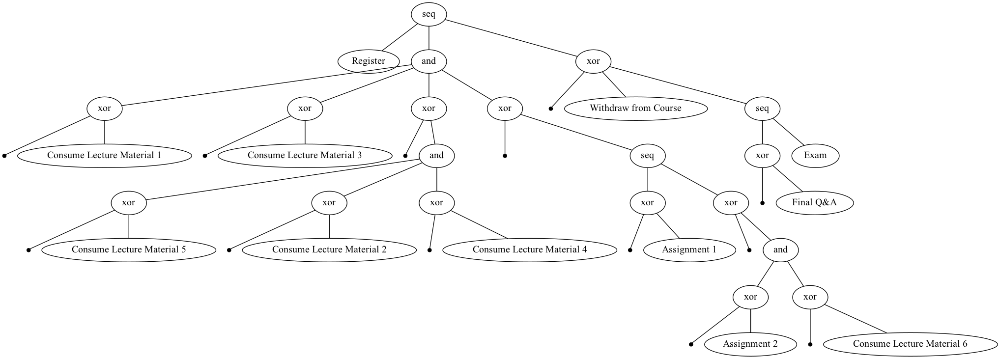

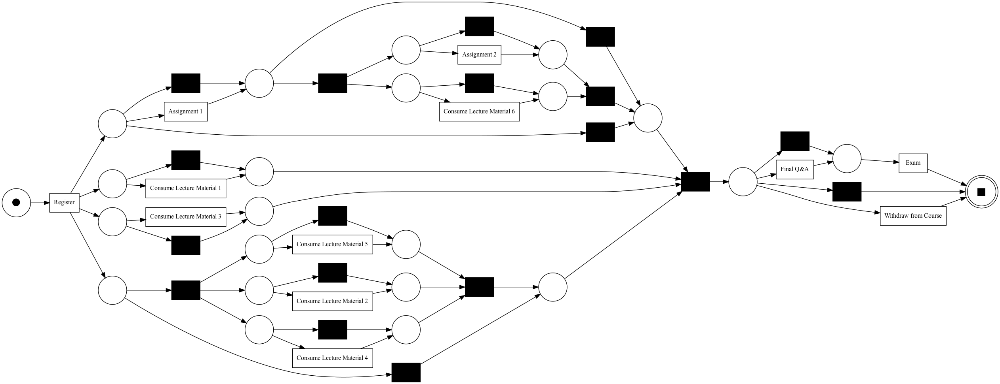

In [99]:
generate_output(log)

##### IM threshold 0.2

replaying log with TBR, completed variants ::   0%|          | 0/432 [00:00<?, ?it/s]

Fitness score: 69.3


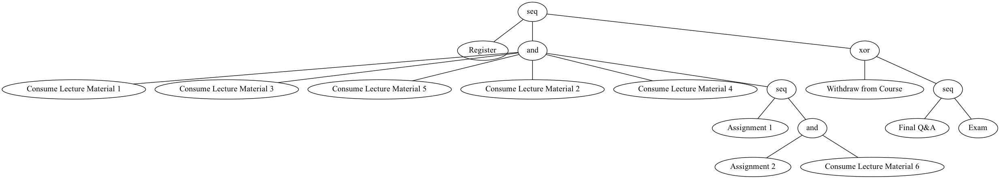

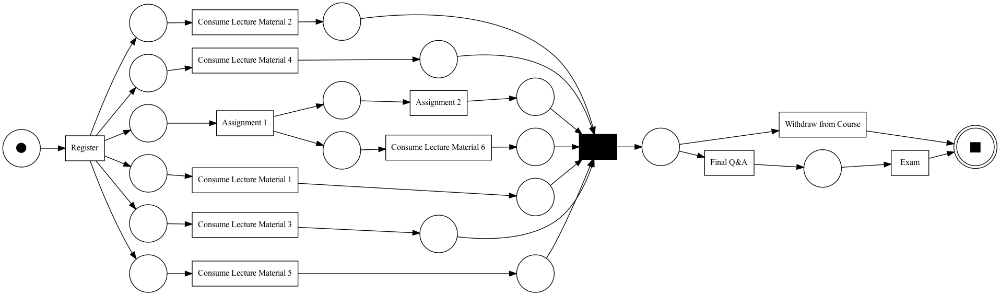

In [103]:
generate_output(log, 0.2)

#### Log: Variant 03
##### IM threshold 0

replaying log with TBR, completed variants ::   0%|          | 0/2 [00:00<?, ?it/s]

Fitness score: 100.0


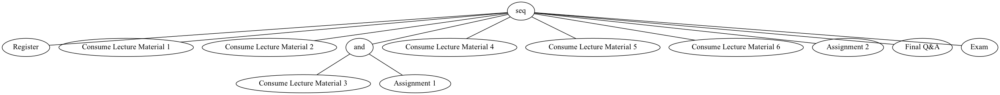

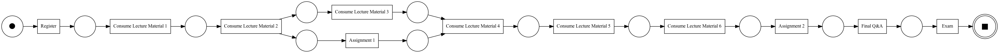

In [104]:
generate_output(log_variant03)

##### IM threshold 0.2

replaying log with TBR, completed variants ::   0%|          | 0/2 [00:00<?, ?it/s]

Fitness score: 100.0


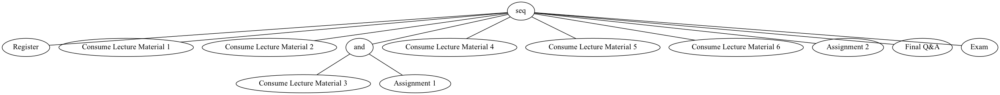

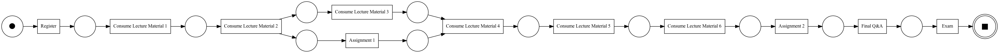

In [105]:
generate_output(log_variant03, 0.2)

#### Log: Variant 05
##### IM threshold 0

replaying log with TBR, completed variants ::   0%|          | 0/18 [00:00<?, ?it/s]

Fitness score: 100.0


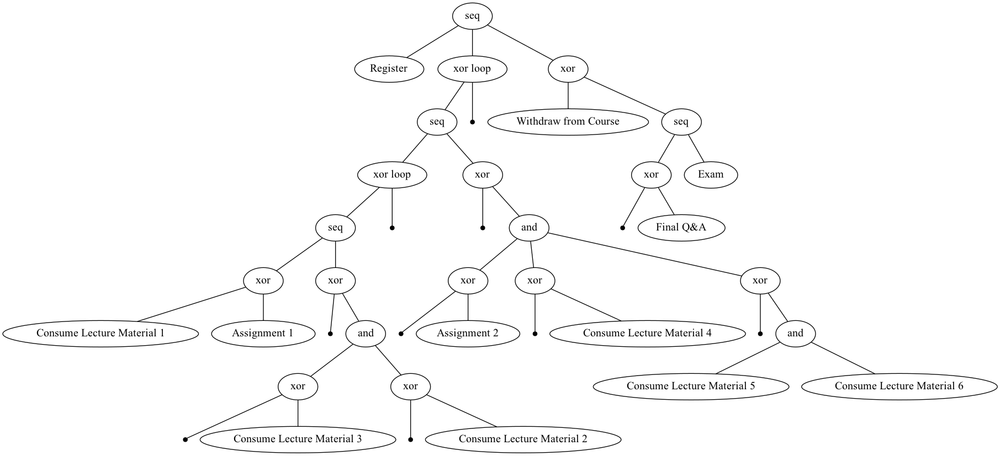

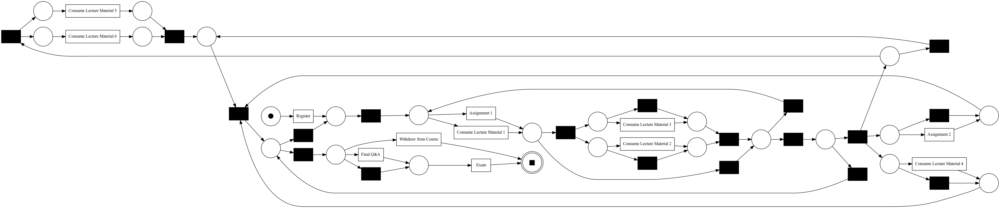

In [106]:
generate_output(log_variant05)

##### IM threshold 0.2

replaying log with TBR, completed variants ::   0%|          | 0/18 [00:00<?, ?it/s]

Fitness score: 76.86196623634558


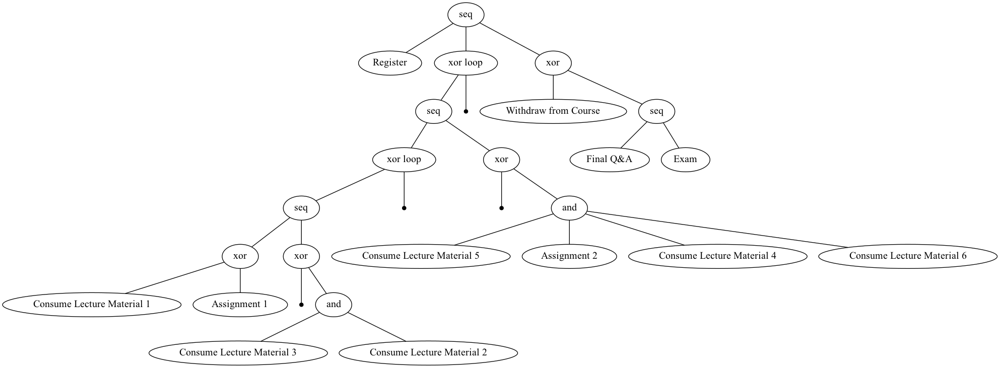

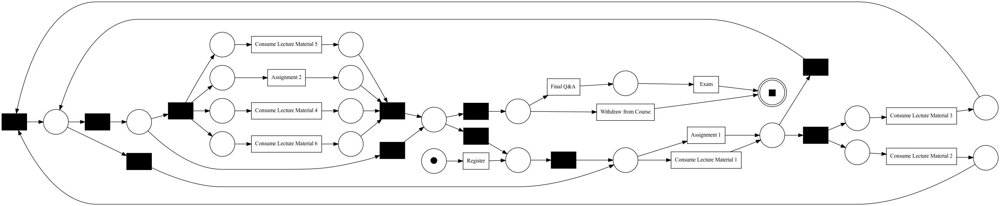

In [107]:
generate_output(log_variant05, 0.2)

#### Log: Exam
##### IM threshold 0

replaying log with TBR, completed variants ::   0%|          | 0/397 [00:00<?, ?it/s]

Fitness score: 100.0


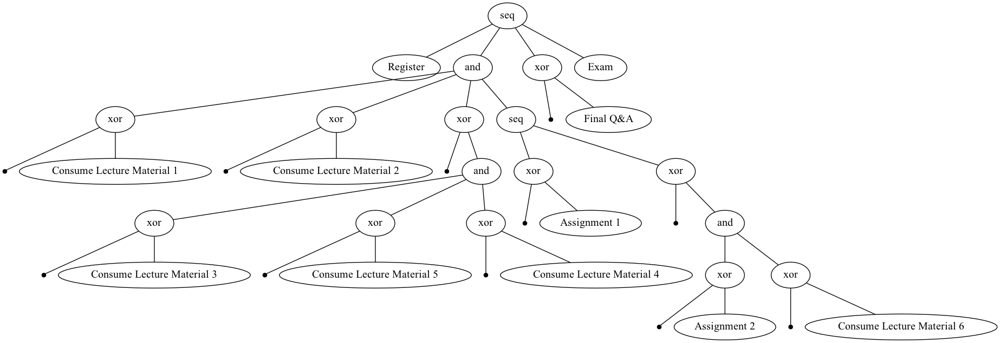

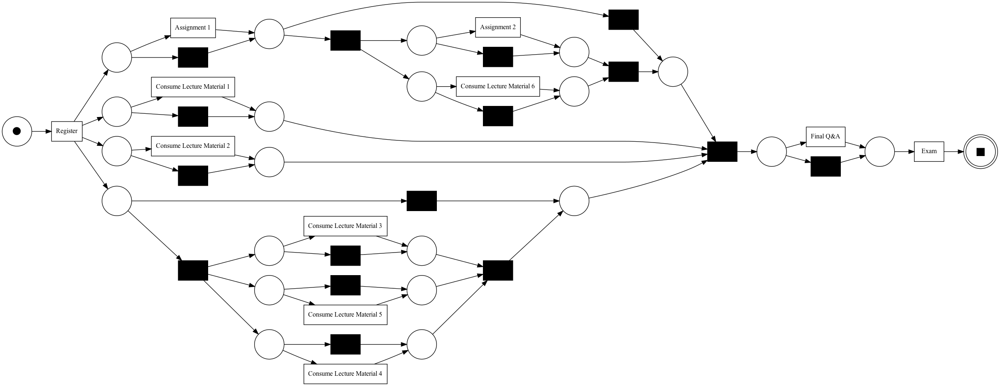

In [108]:
generate_output(log_exam)

##### IM threshold 0.2

replaying log with TBR, completed variants ::   0%|          | 0/397 [00:00<?, ?it/s]

Fitness score: 77.51677852348993


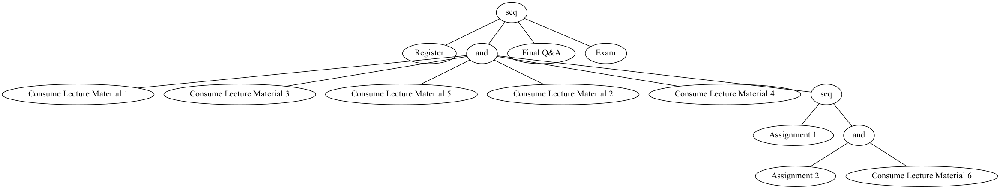

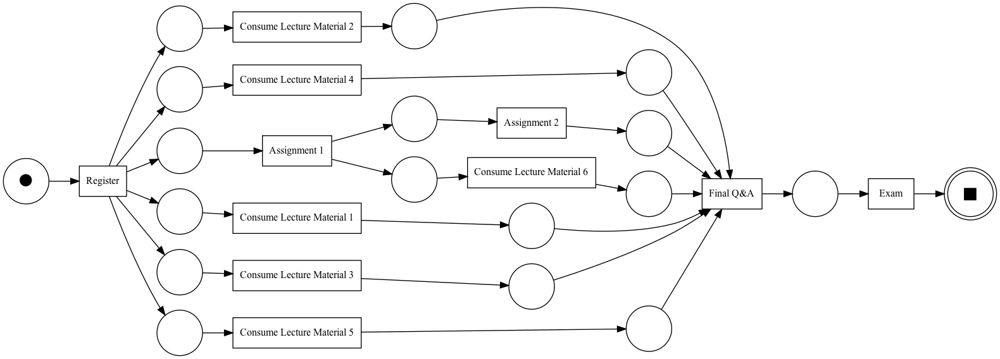

In [121]:
_, petri_net_exam_noise, _ = generate_output(log_exam, 0.2)

### Paths of Excellence

**g)** As lectures are in a constant urge to improve their courses in a way that participants learn as much as possible ;), you are facing the research question to identify *paths of excellence*.
In particular, you should identify how the studying behavior differs between excellent students (**final exam score greater than or equal to 85**) and non-excellent students (**final exam score less than 85**).
Try to answer this research questions using techniques from the preceding Process Mining questions. 

*Hint: There is no single unique solution (e.g., in terms of parameter choice); therefore, it suffices if your "design choices" are reasonble.* \
*Hint: The final exam score is point score that is associated with the "Exam" event.*


In [113]:
from pm4py.algo.filtering.log.attributes import attributes_filter

# calculate paths
params = {
    attributes_filter.Parameters.ATTRIBUTE_KEY: "Points",
    attributes_filter.Parameters.STREAM_FILTER_KEY1: "concept:name",
    attributes_filter.Parameters.STREAM_FILTER_VALUE1: "Exam"
}
excellent_path = attributes_filter.apply_numeric(log, 85, 100, parameters=params)
none_excellent_path = attributes_filter.apply_numeric(log, 0, 84, parameters=params)

Paths of Excellence is:


replaying log with TBR, completed variants ::   0%|          | 0/10 [00:00<?, ?it/s]

Fitness score: 100.0


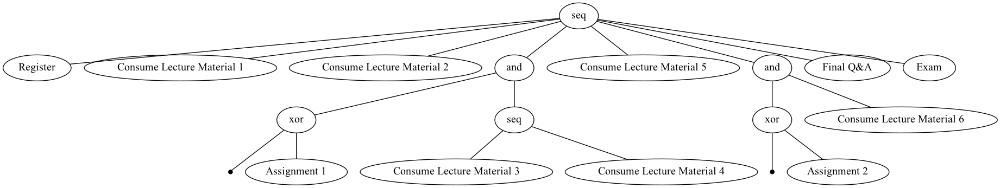

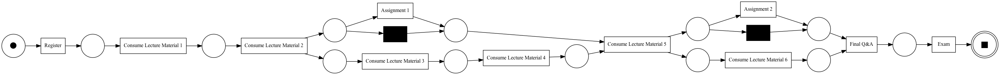

In [117]:
print("Paths of Excellence is:")
generate_output(excellent_path)

Paths of Non-Excellence is:


replaying log with TBR, completed variants ::   0%|          | 0/395 [00:00<?, ?it/s]

Fitness score: 100.0


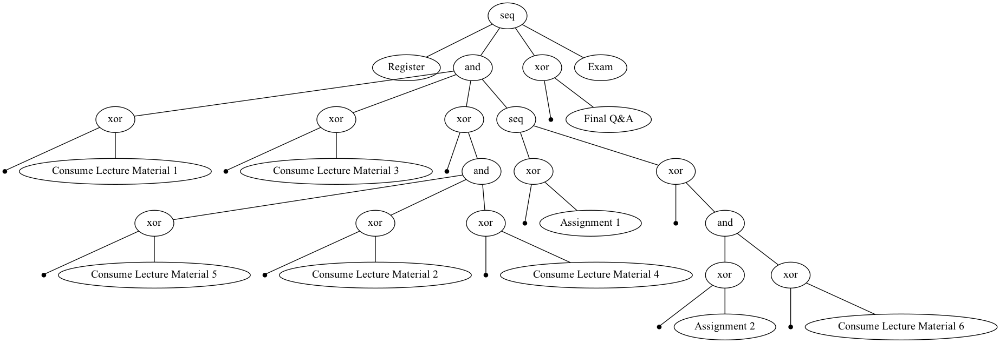

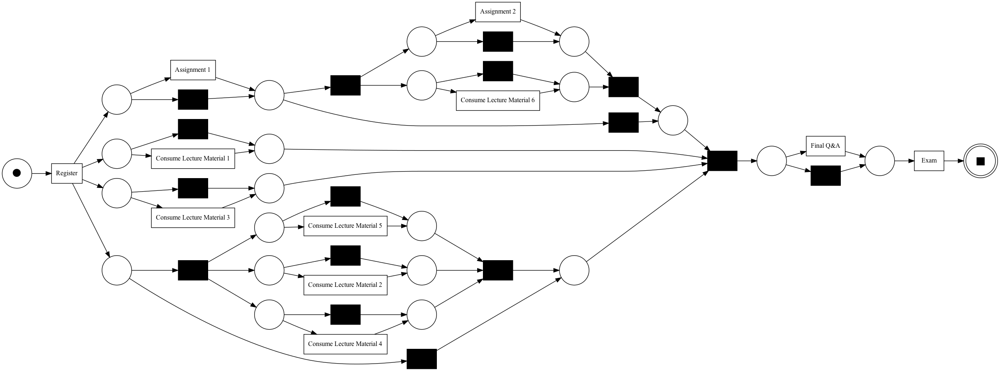

In [116]:
print("Paths of Non-Excellence is:")
generate_output(none_excellent_path)

We filtered the log into two categories:
- All traces ended with "Exam" with value of points between 85-100
- All traces ended with "Exam" with value of points between 0-84

We found that students with excellent points (85-100) follow this path in general which is:
`Register,Consume Lecture Material 1,Consume Lecture Material 2,(Consume Lecture Material 3 / Assignment 1),Consume Lecture Material 4,Consume Lecture Material 5,(Consume Lecture Material 6 / Assignment 2),Final Q&A,Exam`

And all students with points (0-84) follow many paths where consuming the lecture materials happened after doing the assignments or not happening at all or happening without certain order like this path:
`Register,Assignment 1,Consume Lecture Material 1,Consume Lecture Material 2,Consume Lecture Material 3,Assignment 2,Consume Lecture Material 4,Consume Lecture Material 6,Consume Lecture Material 5,Final Q&A,Exam`

The best advice for students here, to make sure to consume all lecture materials and to consume the lecture material in the right time and order before start doing the assignments.

## Performance and Frequency Decoration

**h)** While the discovery of a process model is the most prototypical step in a process mining analysis, its enrichment by frequency and performance statistics is a very common step too. To this end, enrich the Petri net that you discovered for log_exam using Inductive Miner with noise threshold 0.2 by frequency and performance information. Plot two Petri nets decorated with frequency and performance information, respectively.

Describe your results. Can you observe any problems (in particular with respect to the initial process description)?

In [123]:
from pm4py.visualization.petri_net import visualizer as pn_visualizer
parameters = { pn_visualizer.Variants.FREQUENCY.value.Parameters.FORMAT: "png" }

Petri net enriched by frequency information:


replaying log with TBR, completed variants ::   0%|          | 0/397 [00:00<?, ?it/s]

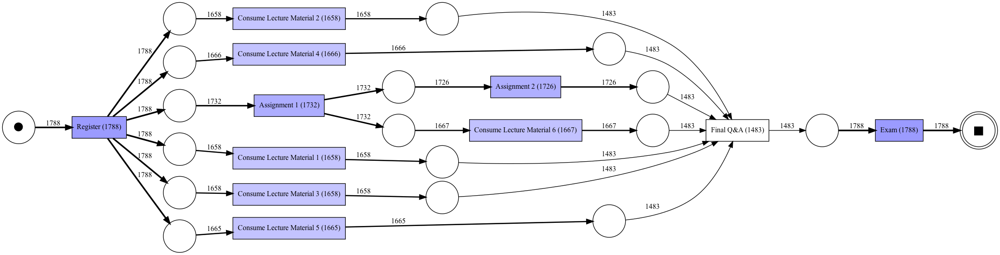

In [125]:
print('Petri net enriched by frequency information:')
gviz = pn_visualizer.apply(
    *petri_net_exam_noise,
    parameters=parameters,
    variant=pn_visualizer.Variants.FREQUENCY,
    log=log_exam
)
pn_visualizer.view(gviz)

Petri net enriched by performance information


replaying log with TBR, completed variants ::   0%|          | 0/397 [00:00<?, ?it/s]

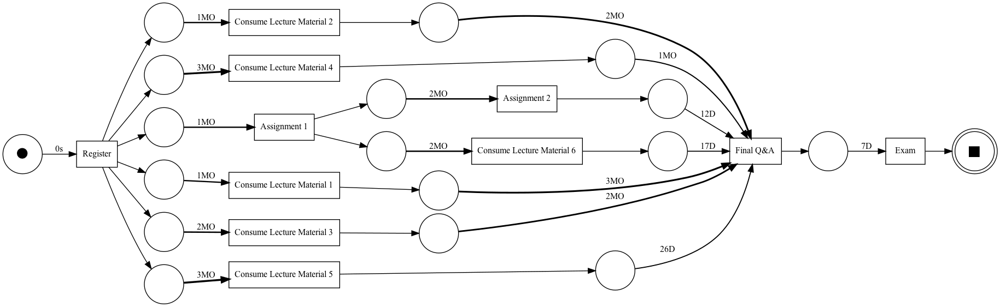

In [126]:
print('Petri net enriched by performance information')
gviz = pn_visualizer.apply(
    *petri_net_exam_noise,
    parameters=parameters,
    variant=pn_visualizer.Variants.PERFORMANCE,
    log=log_exam
)
pn_visualizer.view(gviz)

In the end, more people write the exam than people have looked at the course materials.

## Process Mining Meets Advanced Visualization

### Studying Activity Heatmap

**a)** In this task, we are going to use advanced visualization techniques to create an overview over the course acitivities over time (**log.csv**).
In particular, you shall create a heatmap that shows how often activities occur in a particular week. 
Your heatmap should adhere to the following specification:
- y-axis: Shows the activity labels
- x-axis: Time in terms of course weeks.
- data: The bucket counts should be derived from **log.csv**

Using this configuration, the bucket 2021-11-24 till 2021-12-01 with y-axis label "Exam" and value v would be read as:
In the week between 2021-11-24 and 2021-12-01 v exams took place.

Describe your result. Which patterns do you observe?

In [210]:
df_heat = df.copy()
df_heat['Week/Year'] = df_heat['time:timestamp'].apply(lambda x: "%d/%d" % (x.isocalendar()[1], x.isocalendar()[0]))
df_heat = df_heat.groupby(['Week/Year', 'concept:name']).size().unstack(level=0)
df_heat = df_heat.iloc[:, pd.to_datetime(df_heat.columns, format='%M/%Y').argsort()].reset_index(level=0)

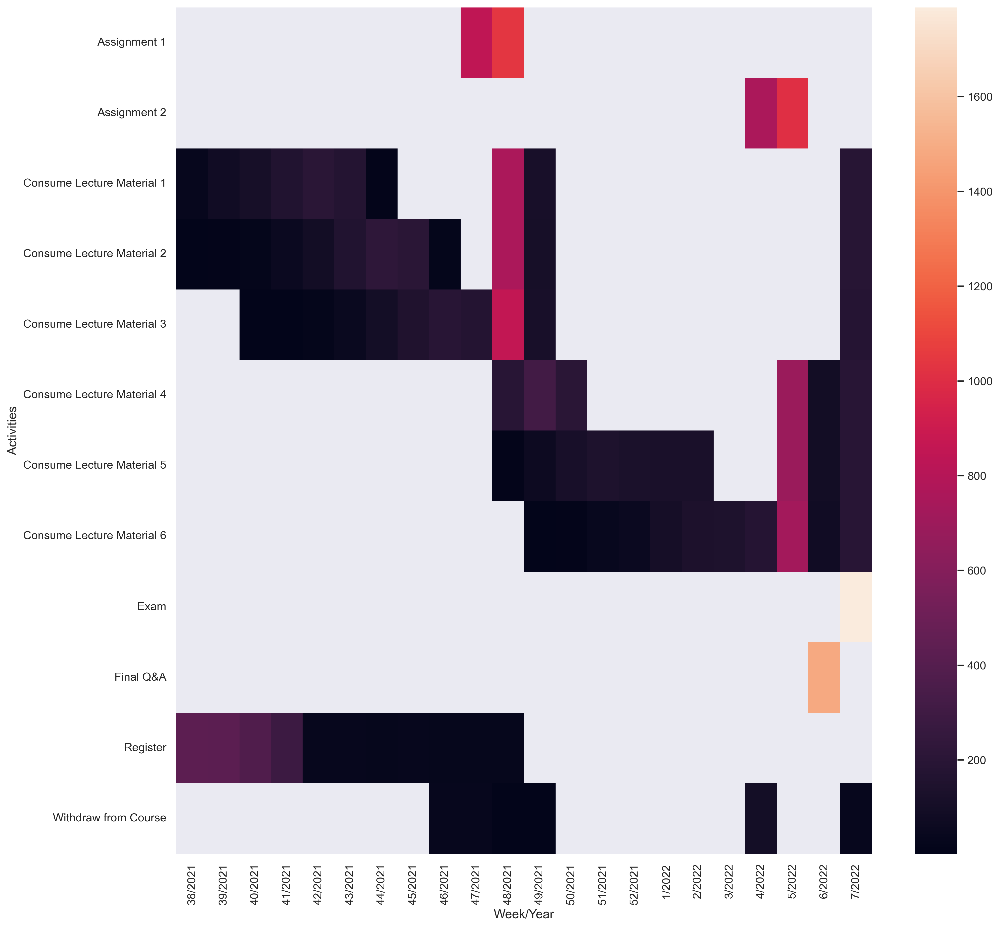

In [211]:
plt.figure(figsize=(15, 15), dpi=300)
s = sns.heatmap(df_heat.set_index('concept:name').iloc[: , 1:])
s.set(ylabel='Activities')
#plt.savefig('heatmap-log.png', bbox_inches="tight")

The data about the two assignments shows the trend of students potentially starting an assignment later than in the earlier.

Lecture material 1 to 3 and 4 to 6 are consumed for assignment 1 and assignment 2, respectively.

One always sees an increase in the consumption of the respective relevant material just before the end of an assignment. Students need to repeat the content in order to solve the assignment.

The number of students writing the assignment is much higher than other activities such as consuming lecture material. This surprises us. Are there students who do not consume the material but write the exam?

Towards the end of the registration period, the first students start to withdraw from the course. During the week of the exam, people withdraw. These are the ones who deregister last minute. There is also a group that was able to deregister a little more timely.

During the week of the exam, the students watch all lecture materials.

**b)** Can you relate the patterns that you observe in the heatmap to the process models that you discovered in question **Q5 - f)**?

*Hint: In contrast to the other questions, this question is deliberately less explicit. You may approach it having the following question in mind: \
Is there a pattern in the heatmap that explains why a certain process model shows a certain behavior/control flow?*

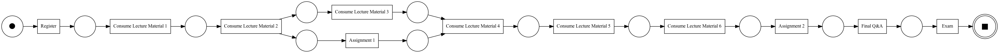

In [16]:
from IPython.display import Image
Image(filename='../output/log_variant03.png')

The previously described behavior, that the first 3 lecture materials are responsible for the first assignment (similar for assignment 2) can also be seen in this Petri net of log variant 3 without noise.

Exercise 1 can only be reached via the first three materials.

In all petri nets you can see that the exam is always at the very end.

### Process Flow

**c)** Assume that another process analyst also had access to the event log. 
Given the data, he created the following novel entities:
- 'Block 1 Complete': The participant downloaded the entire material of the first lecture block (materials 1, 2, and 3). (Not considering when he downloaded it)
- 'Block 1 Incomplete': The participant did not download the entire material of the first lecture block
- 'Block 2 Complete': See 'Block 1 Complete'
- 'Block 2 Incomplete': See 'Block 1 Incomplete'
- 'Ass 1 Excellent': Participant scored at least 85 points in the first part of the assignment
- 'Ass 1 Not Excellent': Participant scored less than 85 points in the part of the assignment
- 'Ass 2 Not Excellent', 'Ass 2 Excellent', 'Exam Not Excellent', 'Exam Excellent': Similar to 'Ass 1 Excellent' and 'Ass 1 Not Excellent'
- 'Withdraw': Participant dropped the course

Based on the entities he derived a set of flow, for example, the flow between 'Block 1 Complete' and 'Ass 1 Excellent' describes how often a partipant who consumed the first lecture block scored excellent in the first part of the assignment.

The next cell loads the entities and flows for you. The flows are stored as a dictionary following the pattern:

    (source, target): flow_value
    
where source and target are indices into the entities list.

Create a **Sankey diagram** that visulizes these flows. Please use `plotly.graph_object.Sankey` to create the diagram.

Briefly **describe** your results.
Moreover, **discuss** this visualization considering your knowlege from the Process Mining task.

*Hint: Having a look at the Sankey diagram will make the analyst's idea behind the entities much clearer.*

In [213]:
with open('../data/sankeyEntities.pkl', 'rb') as f:
    entities = pickle.load(f)
with open('../data/sankeyFlows.pkl', 'rb') as f:
    flows = pickle.load(f)

In [245]:
sources = [flow[0] for flow in flows]
targets = [flow[1] for flow in flows]
values = list(flows.values())

In [244]:
import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.io as pio

pio.renderers.default = 'png'
pyo.init_notebook_mode()

# define sankey diagram
fig = go.Figure(data=[go.Sankey(
    node = dict(
      pad = 15,
      thickness = 20,
      line = dict(color = "black", width = 0.5),
      label = entities,
      color = "blue"
    ),
    link = dict(
      source = sources,
      target = targets,
      value = values
  ))])

fig.update_layout(title_text="Basic Sankey Diagram", font_size=10)
fig.show()

If plotly plot is not visible, please check the output folder.

The flow shows that students who complete blocks excellent are very likely to complete the exam excellent as well.
However, it also shows that a small number of students will not pass the exam excellently.

There is a clear flow from incomplete blocks and the not excellent passing the exam. So if exercises are not used by students, then they perform worse in exams.

Students who do not do the exercises excellently are also likely to do worse on the exams.

Interestingly, a small part of the students, who have completed the blocks, withdraw from the lecture.

# Question 6 - Big Data (15 points) 

### Problem Description
You are working at a finance company that makes loans to individuals and businesses. As a process analyst in *business intelligence team*, you are expected to deliver data-driven insights to improve business processes of the company. Recently, your boss asked you to discover a comprehensive process model of 10 international branches using your big data skills. Your colleague already tried it using commercial on-premise tools, but, due to the immense size of the data, he didn't manage to even load the data to the tool. You are planning to 1) load the datasets from 10 different branches to Hadoop Distributed File System (HDFS), 2) preprocess them using HDFS, and 3) use MapReduce programming model to discover a comprehensive process model. 

### Preparation
The preparation of this problem consists of two steps:

**Preparation step 1**: Replace the filepath to your own filepath to produce the **LoanApplication.csv**.  

In [253]:
import pandas as pd
filepath = "../data/LoanApplication.csv"
original_log = pd.read_csv(filepath,sep=",")
original_log.head()

,eventID,CaseID,Activity,Timestamp,LoanGoal,ApplicationType,RequestedAmount,Action,FirstWithdrawalAmount,Accepted,NumberOfTerms,OfferID,org:resource,MonthlyCost,EventOrigin,EventID,Selected,CreditScore,OfferedAmount,Duration
0,661035,Application_1000086665,A_Create Application,18601566,"Other, see explanation",New credit,5000.0,Created,NaN,NaN,NaN,NaN,User_1,NaN,Application,Application_1000086665,NaN,NaN,NaN,0
1,661036,Application_1000086665,A_Submitted,18601566,"Other, see explanation",New credit,5000.0,statechange,NaN,NaN,NaN,NaN,User_1,NaN,Application,ApplState_161925113,NaN,NaN,NaN,0
2,661040,Application_1000086665,A_Concept,18601632,"Other, see explanation",New credit,5000.0,statechange,NaN,NaN,NaN,NaN,User_1,NaN,Application,ApplState_385184570,NaN,NaN,NaN,0
3,661041,Application_1000086665,W_Complete application,18679694,"Other, see explanation",New credit,5000.0,Obtained,NaN,NaN,NaN,NaN,User_14,NaN,Workflow,Workitem_518019192,NaN,NaN,NaN,0
4,661043,Application_1000086665,A_Accepted,18767152,"Other, see explanation",New credit,5000.0,statechange,NaN,NaN,NaN,NaN,User_5,NaN,Application,ApplState_856156982,NaN,NaN,NaN,0


**Preparation step 2**: In this question, we generate 10 event logs based on the ``original_log``. For randomization, you need to use the sum of the group's matriculation numbers (e.g., a group with 3 students having "100000", "100001", and "100002" as their matriculation numbers will use "300003" for the randomization).

In [254]:
# Below are GIVEN utility functions (do not modify):
import random
import os
def _ramdomize(x):
    random_val = random.randint(5,10)
    return x+random_val

def _randomize_log(log,matriculation_num):
    """Randomize case attributes based on the matriculation number

    Keyword arguments:
    log -- event log
    matriculation_num - sum of matriculation numbers
    """
    attribute_cols = ["Duration"]
    random.seed(matriculation_num)
    for attr in attribute_cols:
        log[attr] = log[attr].apply(_ramdomize)
    return log

def _extract_log(log,iter_num):
    """Extract n-th log to ./generated_logs/

    Keyword arguments:
    log -- event log
    iter_num -- n-th iteration
    """
    log.to_csv("./generated_logs/generated_log-{}.tsv".format(iter_num),header=False,index=False, sep="\t",line_terminator="")

def generate_log(original_log,num_replication,mat_num):
    """Generate logs (randomized by the matriculation number and extracted to ./generated_logs/) 

    Keyword arguments:
    log -- event log
    num_replication -- number of generated logs
    mat_num -- sum of matriculation numbers
    """
    case_col="CaseID"
    timestamp_col = "Timestamp"
    dir_path = "./generated_logs"
    try:
        os.mkdir(dir_path)
    except OSError:
        print ("Directory already exists: %s" % dir_path)
    else:
        print ("Successfully created the directory %s " % dir_path)
    
    for i in range(num_replication):
        print("starts {}".format(i))
        generated_log = original_log.copy(deep=True)
        generated_log[case_col] = str(i) + generated_log[case_col]
        generated_log[timestamp_col] = generated_log[timestamp_col].apply(str).str.zfill(10)
        randomized_log = _randomize_log(generated_log,mat_num)
        _extract_log(randomized_log,i)
        print ("Successfully created %i th log at %s "% (i,dir_path))

Replace the SUM_MAT_NUM to yours to generate logs.

In [255]:
# your code
SUM_MAT_NUM = 154031 
NUM_REPITITION=10
generate_log(original_log,NUM_REPITITION,SUM_MAT_NUM)

Successfully created the directory ./generated_logs 
starts 0
Successfully created 0 th log at ./generated_logs 
starts 1
Successfully created 1 th log at ./generated_logs 
starts 2
Successfully created 2 th log at ./generated_logs 
starts 3
Successfully created 3 th log at ./generated_logs 
starts 4
Successfully created 4 th log at ./generated_logs 
starts 5
Successfully created 5 th log at ./generated_logs 
starts 6
Successfully created 6 th log at ./generated_logs 
starts 7
Successfully created 7 th log at ./generated_logs 
starts 8
Successfully created 8 th log at ./generated_logs 
starts 9
Successfully created 9 th log at ./generated_logs 


### 6.1. Hadoop Distributed File System (HDFS)

Now, it's time to work with the Hadoop Distributed File System (HDFS). The goal of this task is to merge 10 event logs at your disk using HDFS. Follow the instructions below and show your results in each step (screenshots of the command line). We use "letter identifier" for this task (The letter identifier is the string consisting of the first letters of the group memebers' first names, e.g., for the group with "Antonio Rüdiger", "Bernd Leno", "Christian Günter", the indentifier is "ABC").

    1) Import the event logs to your Docker engine (at /usr/local/hadoop/(identifier)-generated-logs/).
    2) Upload the event logs to the running HDFS (at /input/(identifier)-generated-logs/). 
    3) Merge all the files and copy the result back to HDFS (at /input/(identifier)-final-log-10.tsv).
    4) Merge 6 files (you can randomly select) and copy the result back to HDFS (at /input/(identifier)-final-log-6.tsv).
    5) Merge 2 files (you can randomly select) and copy the result back to HDFS (at /input/(identifier)-final-log-2.tsv).
    6) Print out the completely-merged event log from 3), i.e., "(identifier)-final-log-10.tsv", in the command line (the screenshot may contain 10 rows).

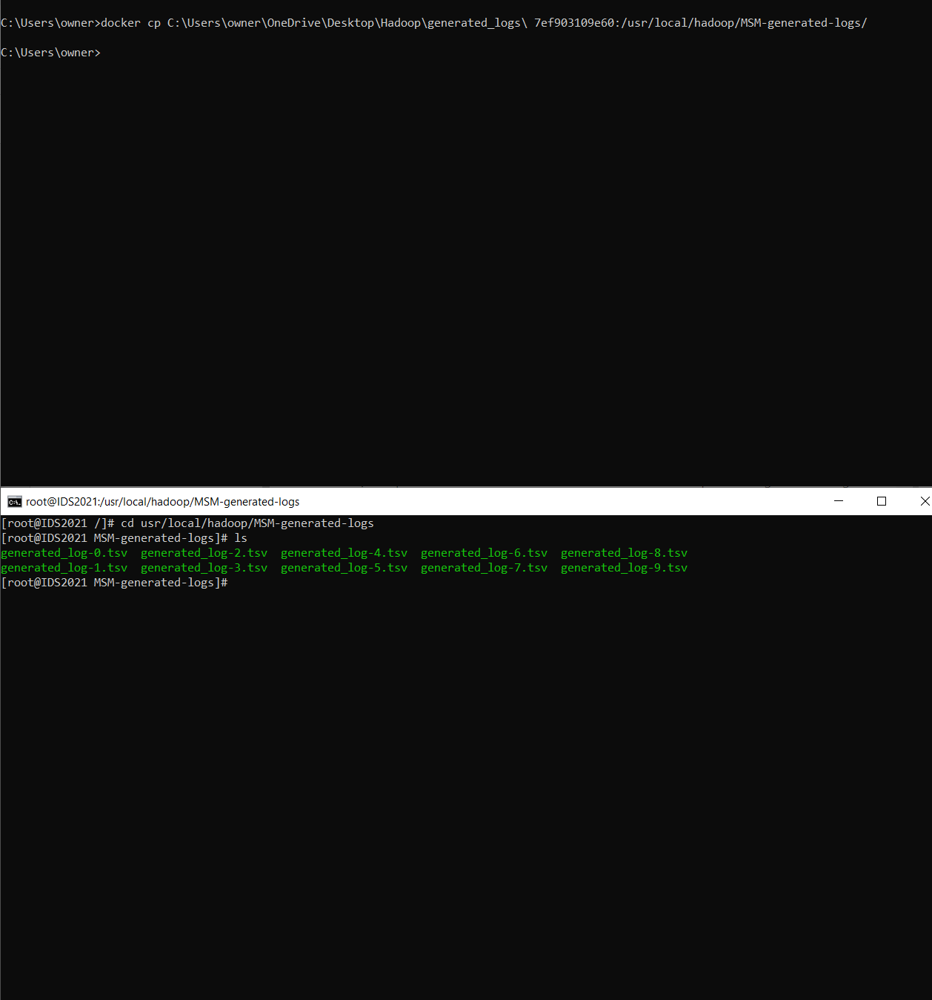

In [267]:
from IPython.display import Image
Image(filename='../q6/6-1.PNG')

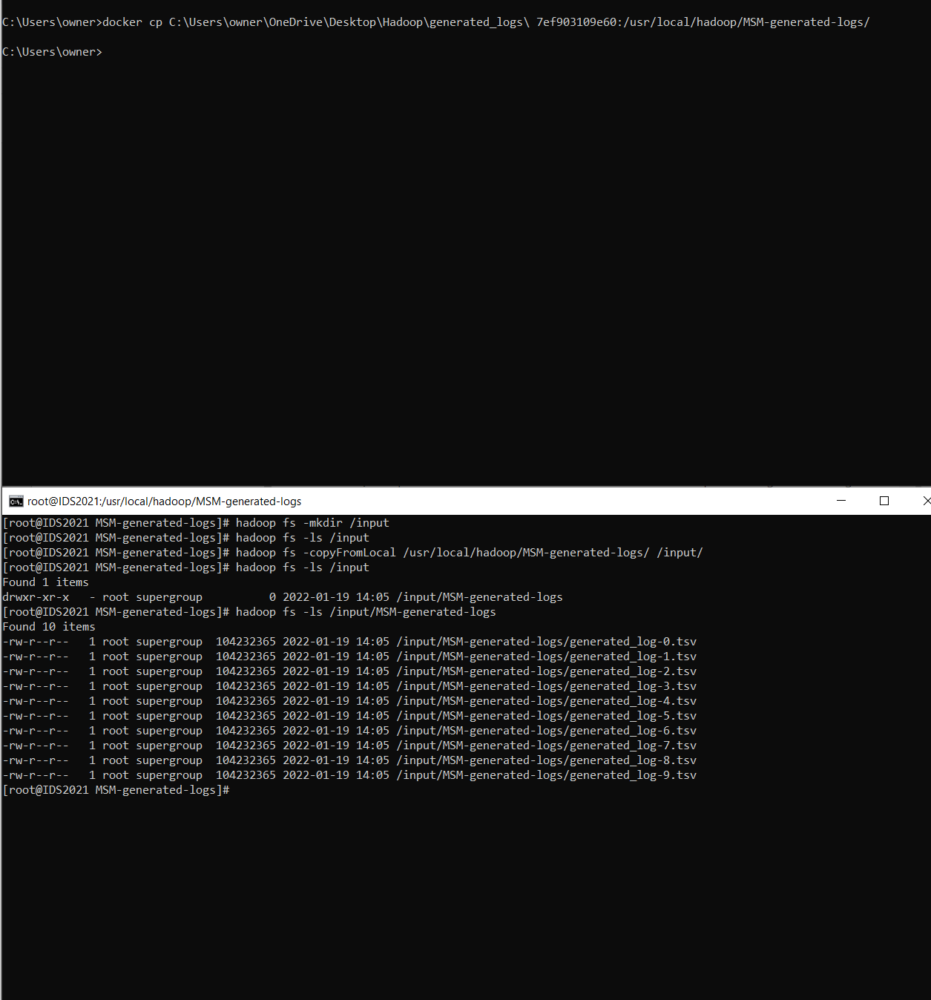

In [266]:
Image(filename='../q6/6-2.PNG')

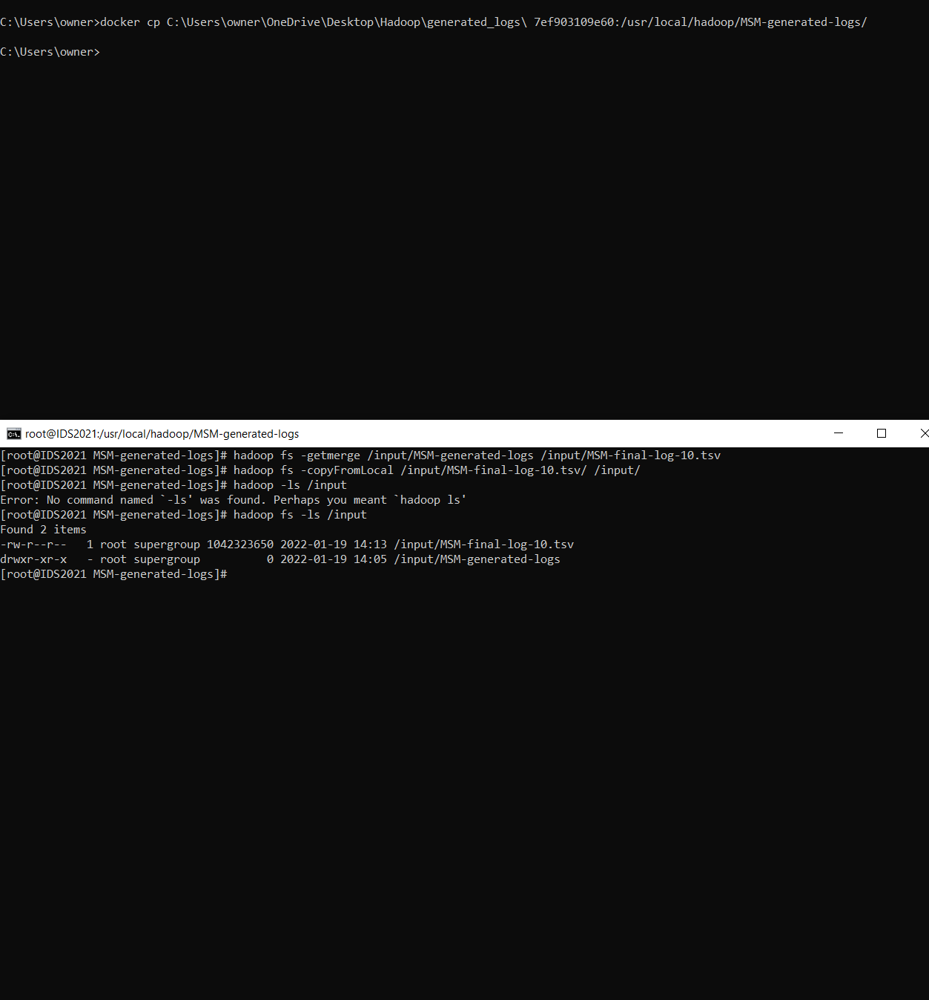

In [268]:
Image(filename='../q6/6-3.PNG')

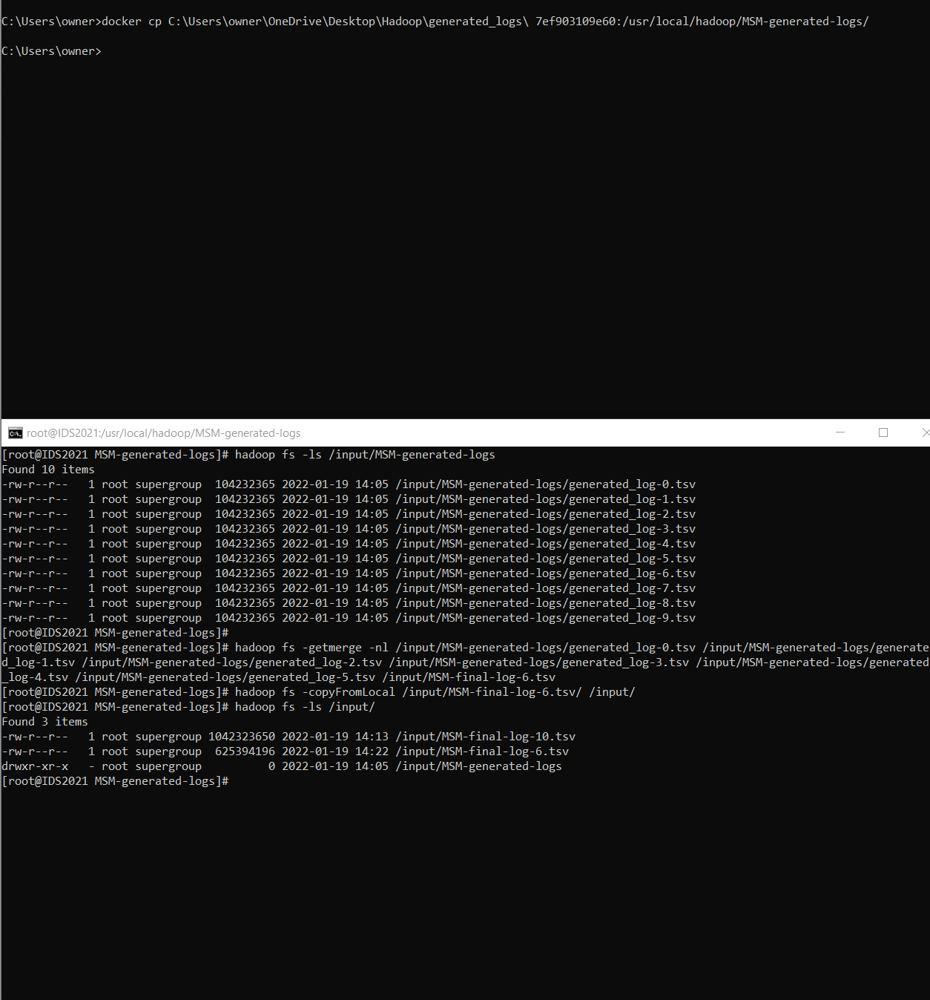

In [269]:
Image(filename='../q6/6-4.PNG')

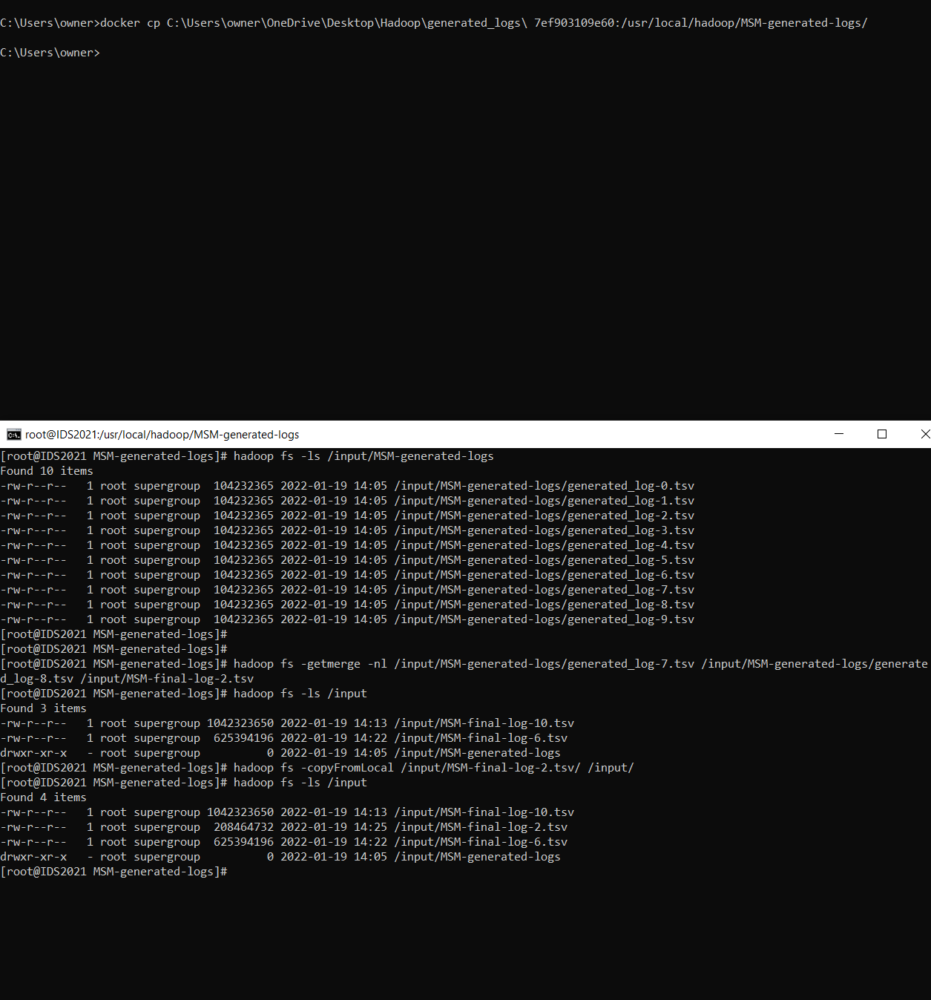

In [270]:
Image(filename='../q6/6-5.PNG')

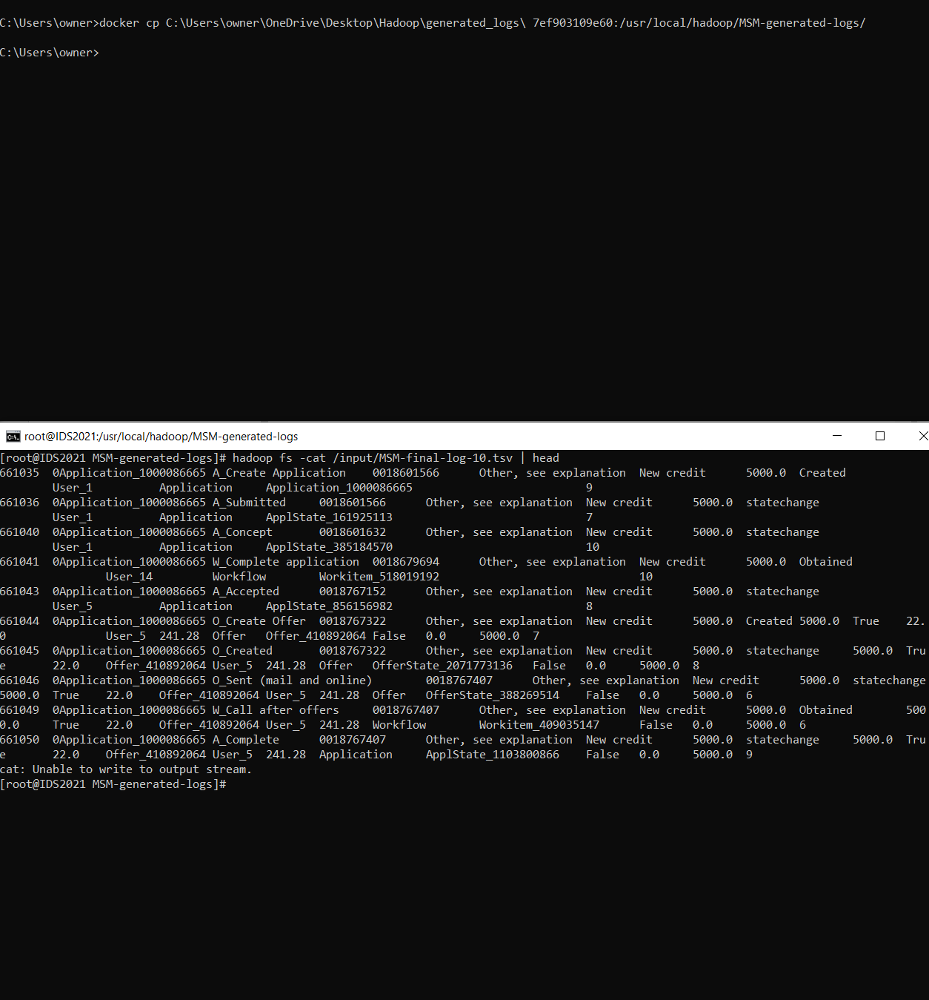

In [271]:
Image(filename='../q6/6-6.PNG')

### 6.2. Process Discovery

Discover a process model from the completely merged event log using MapReduce algorithms. Explain how you discover the process model with the following deliverables:

    1) Mapper function (as python file(s))
    2) Reducer function (as python file(s))
    3) Hadoop commands for MapReduce computation (as text file)
    4) Jupyter notebook script that visualize (1) a directly-follows graph and (2) a Petri net  based on the computed directly-follows relations.

<font color='red'>Important!</font> Please note that in this task, your result will be evaluated based on whether they are reproducible from your explanation. If you skip MapReduce computations for this task, you will get 0 points.The deliverables of 1), 2), and 3) should be submitted as outputs. 

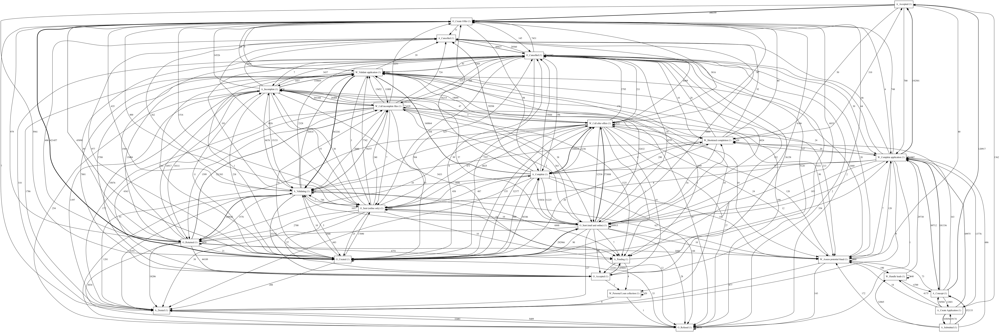

In [259]:
# 1. Import libraries
import os
import csv
from pm4py.objects.conversion.dfg import converter as dfg_mining
from pm4py.visualization.dfg import visualizer as dfg_visualization
from pm4py.visualization.petri_net import visualizer as pn_visualizer


# 2. preprocessing
with open('../q6/directly-follows-relation.txt') as file:
    file_reader = csv.reader(file, delimiter='\t')
    dfg = dict()
    for row in file_reader:
        _from, _to = row[0].split(',')
        rel = (_from, _to)
        freq = int(row[1])
        dfg[rel] = freq

# 3. Visualize Directly-follows-graph (DFG)
gviz = dfg_visualization.apply(dfg)
dfg_visualization.view(gviz)
dfg_visualization.save(gviz, "../q6/dfg.png")

# 4. Discover and Visualize Workflow-Net
net, im, fm = dfg_mining.apply(dfg)
gviz = pn_visualizer.apply(net, im, fm)
pn_visualizer.view(gviz)
dfg_visualization.save(gviz, "../q6/pt.png")


### 6.3. Performance Analysis

a) Compute the total service time for each case based on MapReduce algorithms using the completely-merged event log (i.e., (identifier)-final-log-10.tsv) and visualize 100 cases that show the longest total service time using any chart.
    
The deliverables of 1), 2), 3) and 4) should be submitted as outputs:
```
1) Mapper function (as python file(s))
2) Reducer function (as python file(s))
3) Hadoop commands for MapReduce calculation (as text file)
4) Result: total service times for cases (as text file)
```

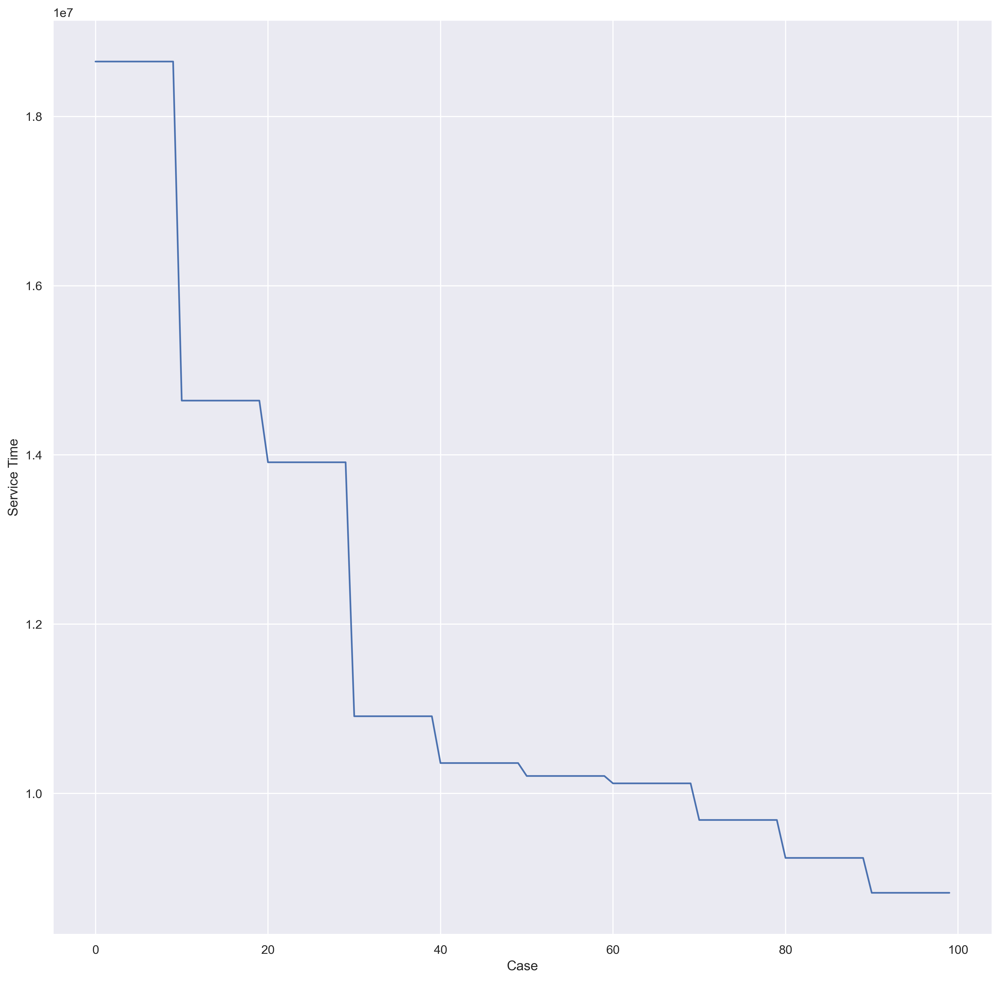

In [264]:
from matplotlib import pyplot as plt

with open('../q6/service_time.txt') as file:
   file_reader = csv.reader(file, delimiter='\t')
   service_time = dict()
   for row in file_reader:
       freq = float(row[1])
       service_time[row[0]] = freq

plt.figure(figsize=(15,15), dpi=300)
sorted_service_time = sorted(service_time.items(), key=lambda kv: kv[1],reverse=True)
case=[]
service_time_percase=[]
for tup in sorted_service_time[:100]:
   case.append(tup[0])
   service_time_percase.append(tup[1])

plt.xlabel('Case')
plt.ylabel('Service Time')
plt.plot(service_time_percase)

b) Compare the (approximate) computation time of the service time calculation between 1. the completely-merged event log (i.e., (identifier)-final-log-10.tsv), 2. 6-merged event log (i.e., (identifier)-final-log-6.tsv), and 3. 2-merged event log (i.e., (identifier)-final-log-2.tsv). Interpret the difference (e.g., the computation time scales linearly with the increasing number of events).

Approximate computation time of the service time calculation of

### 1- MSM-final-log-10.tsv:

- real    0m26.407s
- user    0m36.110s
- sys     0m4.508s


### 2- MSM-final-log-6.tsv:

- real    0m16.793s
- user    0m25.799s
- sys     0m2.394s


### 3- MSM-final-log-2.tsv:

- real    0m7.973s
- user    0m13.628s
- sys     0m0.855s


According to this statistics, we notice the computation time scales decreases when number of events decreases also.

When we go from 10 merged logs with filesize (994 MB) to 6 merged logs with filesize (596 MB), time decreases from 26 seconds to 16 seconds
and when we go from 6 merged logs with filesize (596 MB) to 2 merged logs with filesize (198 MB) , time decreases from 16 seconds to 8 seconds
Hence, small partition sizes reduce sorting time, but having a large number of reducers may be impractical.